# Computer Vision Tasks
## Deep Learning and Generative AI
### [Dr. Elias Jacob de Menezes Neto](https://docente.ufrn.br/elias.jacob)

# Summary

## Keypoints

- Computer vision techniques like image classification, object detection, and segmentation enable machines to perceive and understand visual data

- Image classification assigns a single label to an entire image, while object detection identifies and locates multiple objects using bounding boxes

- Image segmentation provides pixel-level labeling, delineating precise object shapes and boundaries

- Transfer learning leverages knowledge from pre-trained models to solve related problems, enabling effective training with limited data

- Feature extraction transforms raw images into numerical embeddings that capture relevant information for downstream tasks

- Embeddings enable powerful applications like similarity search for finding related images or items

- Evaluation metrics like Intersection over Union (IoU) quantify the accuracy of object detection models by measuring bounding box overlap

## Takeaways

- Computer vision has wide-ranging applications across industries, from autonomous vehicles to medical imaging analysis

- Different computer vision tasks offer varying levels of detail, from basic image labels to precise pixel-wise segmentation

- CNNs and deep learning have revolutionized computer vision by automatically learning hierarchical image features

- Transfer learning and feature extraction with pre-trained models greatly simplify developing effective vision systems

- Embeddings provide a way to mathematically represent the "essence" of images for comparison and retrieval

- Data augmentation and evaluation metrics are key considerations when training and assessing computer vision models

- Understanding the strengths and limitations of each vision task is crucial for selecting the right approach for a given problem

- The ability to quantify visual similarity through embeddings enables building powerful search and recommendation systems

In [1]:
import gc
import io
import os
from argparse import Namespace
from glob import glob
from pathlib import Path
from typing import Any, Callable, Dict, List, Optional, Tuple

import datasets
import librosa
import librosa.display
import lightning as L
import matplotlib.colors
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import torch
import torchmetrics
import torchvision
import wandb
from PIL import Image, ImageDraw, ImageFont
from sklearn.model_selection import train_test_split
from torch import nn
from torch.nn import functional as F
from torch.utils.data import DataLoader
from torchvision.transforms import v2
from tqdm import tqdm

# Helper functions for this class

In [2]:
def display_image_with_label(image_tensor: torch.Tensor, label: int) -> None:
    """
    Display an image with its corresponding label.

    Args:
        image_tensor (torch.Tensor): The image tensor to display.
        label (int): The label associated with the image.
    """

    # Display the image using matplotlib
    # image_tensor.permute(1, 2, 0) changes the order of dimensions from (C, H, W) to (H, W, C)
    # This is necessary because matplotlib expects the image in (H, W, C) format
    plt.imshow(image_tensor.permute(1, 2, 0))

    # Set the title of the plot to display the label
    plt.title(f"Label: {label}")

    # Show the plot
    plt.show()

In [3]:
def convert_coco_to_voc(bounding_boxes_coco: torch.Tensor) -> torch.Tensor:
    """
    Convert bounding boxes from COCO format to Pascal VOC format.

    In COCO format, bounding boxes are represented as [x, y, width, height].
    In Pascal VOC format, bounding boxes are represented as [x_min, y_min, x_max, y_max].

    Args:
        bounding_boxes_coco (torch.Tensor): Bounding boxes in COCO format.

    Returns:
        torch.Tensor: Bounding boxes in Pascal VOC format.
    """
    # Check if the input is a tensor, if not, convert it to a tensor
    # This ensures that the function can handle inputs that are not already tensors
    if not isinstance(bounding_boxes_coco, torch.Tensor):
        bounding_boxes_coco = torch.tensor(bounding_boxes_coco)

    # Initialize an empty tensor with the same shape as the input tensor
    # This tensor will store the converted bounding boxes in Pascal VOC format
    bounding_boxes_voc = torch.zeros_like(bounding_boxes_coco)

    # Assign x_min (same as x in COCO format)
    # The first column in Pascal VOC format is the same as the first column in COCO format
    bounding_boxes_voc[:, 0] = bounding_boxes_coco[:, 0]  # x_min

    # Assign y_min (same as y in COCO format)
    # The second column in Pascal VOC format is the same as the second column in COCO format
    bounding_boxes_voc[:, 1] = bounding_boxes_coco[:, 1]  # y_min

    # Calculate x_max (x + width in COCO format)
    # The third column in Pascal VOC format is the sum of the first and third columns in COCO format
    bounding_boxes_voc[:, 2] = (
        bounding_boxes_coco[:, 0] + bounding_boxes_coco[:, 2]
    )  # x_max

    # Calculate y_max (y + height in COCO format)
    # The fourth column in Pascal VOC format is the sum of the second and fourth columns in COCO format
    bounding_boxes_voc[:, 3] = (
        bounding_boxes_coco[:, 1] + bounding_boxes_coco[:, 3]
    )  # y_max

    # Return the converted bounding boxes in Pascal VOC format
    return bounding_boxes_voc

In [59]:
def get_instance_segmentation_model(
    num_classes: int,
) -> torchvision.models.detection.MaskRCNN:
    """
    Load a pre-trained Mask R-CNN model and modify it for instance segmentation with a specified number of classes.

    Args:
        num_classes (int): The number of classes for the instance segmentation model.

    Returns:
        torchvision.models.detection.MaskRCNN: The modified Mask R-CNN model.
    """
    # Load an instance segmentation model pre-trained on the COCO dataset
    # This model uses a ResNet-50 backbone with a Feature Pyramid Network (FPN)
    model = torchvision.models.detection.maskrcnn_resnet50_fpn_v2(weights="DEFAULT")

    # Get the number of input features for the classifier head
    # This is needed to replace the classifier head with a new one
    input_features_classifier = model.roi_heads.box_predictor.cls_score.in_features

    # Replace the pre-trained classifier head with a new one for the specified number of classes
    # FastRCNNPredictor is used to create a new classifier head
    model.roi_heads.box_predictor = (
        torchvision.models.detection.faster_rcnn.FastRCNNPredictor(
            input_features_classifier,  # Number of input features for the classifier
            num_classes,  # Number of output classes (including background)
        )
    )

    # Get the number of input features for the mask classifier head
    # This is needed to replace the mask classifier head with a new one
    input_features_mask = model.roi_heads.mask_predictor.conv5_mask.in_channels
    hidden_layer_size = (
        256  # Define the size of the hidden layer for the mask predictor
    )

    # Replace the pre-trained mask predictor head with a new one for the specified number of classes
    # MaskRCNNPredictor is used to create a new mask predictor head
    model.roi_heads.mask_predictor = (
        torchvision.models.detection.mask_rcnn.MaskRCNNPredictor(
            input_features_mask,  # Number of input features for the mask predictor
            hidden_layer_size,  # Size of the hidden layer
            num_classes,  # Number of output classes (including background)
        )
    )

    # Return the modified Mask R-CNN model
    return model

In [53]:
def get_transform(is_training: bool) -> torchvision.transforms.v2.Compose:
    """
    Get a composition of image transformations for training or evaluation.

    Args:
        is_training (bool): Flag indicating whether the transformations are for training or evaluation.

    Returns:
        torchvision.transforms.v2.Compose: A composition of image transformations.
    """
    # Initialize a list to hold the transformations
    transformation_list = []

    # Convert the image to a torchvision Image
    # This ensures compatibility with torchvision's transformation functions
    transformation_list.append(torchvision.transforms.v2.ToImage())

    # If training, add a random horizontal flip transformation
    # This helps in data augmentation by randomly flipping the image horizontally with a probability of 0.5
    if is_training:
        transformation_list.append(torchvision.transforms.v2.RandomHorizontalFlip(0.5))

    # Convert the image to float32 and scale pixel values to [0, 1]
    # This standardizes the image data, which is important for neural network training
    transformation_list.append(
        torchvision.transforms.v2.ToDtype(torch.float32, scale=True)
    )

    # Convert the image to a pure tensor
    # This final transformation ensures the image is in tensor format, ready for input into the model
    transformation_list.append(torchvision.transforms.v2.ToPureTensor())

    # Compose all transformations into a single transformation
    # This allows us to apply all the transformations in sequence with a single call
    return torchvision.transforms.v2.Compose(transformation_list)

In [54]:
def show_image_with_bbox(image, annotations):
    """
    Display an image with bounding boxes and category labels drawn on it.

    Args:
        image (PIL.Image.Image): The image on which to draw the bounding boxes and labels.
        annotations (dict): A dictionary containing bounding box coordinates and category indices.
            Expected keys are:
                - "id": List of annotation IDs.
                - "bbox": List of bounding boxes, each represented as [x, y, width, height].
                - "category": List of category indices corresponding to each bounding box.
    """

    # Create a drawing context to draw on the image
    draw_context = ImageDraw.Draw(image)

    # Iterate over each annotation to draw bounding boxes and labels
    for annotation_index in range(len(annotations["id"])):
        # Extract the bounding box coordinates and category index for the current annotation
        bounding_box = annotations["bbox"][annotation_index]
        category_index = annotations["category"][annotation_index]
        x, y, width, height = tuple(bounding_box)

        # Draw the bounding box on the image
        # The rectangle is defined by the top-left corner (x, y) and the bottom-right corner (x + width, y + height)
        draw_context.rectangle((x, y, x + width, y + height), outline="red", width=1)

        # Load the default font for drawing the category label
        # The size parameter is set to 18 for better visibility
        font = ImageFont.load_default(size=18)

        # Draw the category label at the top-left corner of the bounding box
        # id_to_label is assumed to be a dictionary mapping category indices to category names
        draw_context.text((x, y), id_to_label[category_index], fill="red", font=font)

    # Return the image with the drawn bounding boxes and labels
    return image

# Beyond Image Classification

In the previous notebook, we explored how to train a model to classify images into various categories.
However, computer vision encompasses a wide array of other tasks that extend beyond simple image classification. Let's give a brief overview of some of these tasks.

# Image Classification for Less Obvious Things

Typically, an image classifier is designed to identify and classify visual images. However, many different types of data can be transformed into images, allowing image recognition models to perform a variety of tasks beyond traditional image classification.

## Case Study: Sound Classification with ResNet

In this section, I'll show you how to a sound classification problem using the UrbanSound8K dataset. This dataset comprises 8,732 labeled sound excerpts, each lasting up to 4 seconds. The sounds are categorized into 10 distinct classes:

- Air Conditioner
- Car Horn
- Children Playing
- Dog Bark
- Drilling
- Engine Idling
- Gun Shot
- Jackhammer
- Siren
- Street Music

### Approach

To use an image recognizer for this task, we need to convert the audio files into a visual format that can be processed by our model. This is achieved by transforming the audio signals into spectrogram images.

#### What is a Spectrogram?

A spectrogram is a visual representation of the spectrum of frequencies in a sound signal as it varies with time. It provides a way to visualize the intensity of different frequencies at different times, making it an excellent input for image-based models.

By converting audio files into spectrograms, we transform the problem of sound classification into an image classification task. This highlights the versatility of image classifiers and opens up possibilities for various applications across different data types. In the following sections, we will walk through the process of creating spectrograms from audio files and training a ResNet model to classify these sound excerpts.

In [7]:
# Use the glob module to find all .wav audio files in the UrbanSound8K dataset directory
# The pattern 'data/UrbanSound8K/*/*.wav' matches all .wav files in subdirectories of 'data/UrbanSound8K'
# This will return a list of file paths to the audio files
audio_files = glob("data/UrbanSound8K/*/*.wav")

# Access the first audio file in the list
# This is useful for inspecting the file path or loading the audio file for further processing
audio_files[0]

'data/UrbanSound8K/fold2/203929-7-5-1.wav'

In [8]:
len(audio_files)

8732

In [9]:
# Read the CSV file containing labels for the UrbanSound8K dataset
# The CSV file 'UrbanSound8K.csv' contains metadata about the audio files, such as their labels and file paths
# pd.read_csv is used to load the CSV file into a pandas DataFrame
labels = pd.read_csv("data/UrbanSound8K/UrbanSound8K.csv")

# Display the DataFrame containing the labels and metadata
# This allows us to inspect the contents of the CSV file, including the labels and other relevant information
labels

,slice_file_name,fsID,start,end,salience,fold,classID,class
0,100032-3-0-0.wav,100032,0.000000,0.317551,1,5,3,dog_bark
1,100263-2-0-117.wav,100263,58.500000,62.500000,1,5,2,children_playing
2,100263-2-0-121.wav,100263,60.500000,64.500000,1,5,2,children_playing
3,100263-2-0-126.wav,100263,63.000000,67.000000,1,5,2,children_playing
4,100263-2-0-137.wav,100263,68.500000,72.500000,1,5,2,children_playing
...,...,...,...,...,...,...,...,...
8727,99812-1-2-0.wav,99812,159.522205,163.522205,2,7,1,car_horn
8728,99812-1-3-0.wav,99812,181.142431,183.284976,2,7,1,car_horn
8729,99812-1-4-0.wav,99812,242.691902,246.197885,2,7,1,car_horn
8730,99812-1-5-0.wav,99812,253.209850,255.741948,2,7,1,car_horn


In [10]:
labels["class"].unique()

array(['dog_bark', 'children_playing', 'car_horn', 'air_conditioner',
       'street_music', 'gun_shot', 'siren', 'engine_idling', 'jackhammer',
       'drilling'], dtype=object)

In [11]:
# Initialize an empty dictionary to store labels and their corresponding file names
dict_labels = {}

# Iterate over each unique class label in the 'class' column of the labels DataFrame
for label in labels["class"].unique():
    # For each unique label, filter the DataFrame to get the file names corresponding to that label
    # Convert the filtered file names to a list and remove duplicates using set()
    # Store the list of unique file names in the dictionary with the label as the key
    dict_labels[label] = list(
        set(labels[labels["class"] == label]["slice_file_name"].values.tolist())
    )

# Iterate over the dictionary to print the number of instances for each label
for k, v in dict_labels.items():
    print(f"Label {k} has {len(v)} instances")

# Calculate and print the total number of instances across all labels
# This is done by summing the lengths of the lists in the dictionary
print(f"The total number of instances is {sum([len(v) for v in dict_labels.values()])}")

Label dog_bark has 1000 instances
Label children_playing has 1000 instances
Label car_horn has 429 instances
Label air_conditioner has 1000 instances
Label street_music has 1000 instances
Label gun_shot has 374 instances
Label siren has 929 instances
Label engine_idling has 1000 instances
Label jackhammer has 1000 instances
Label drilling has 1000 instances
The total number of instances is 8732


In [12]:
def get_label_from_path(audio_file_path: str) -> str:
    """
    Retrieve the label for a given audio file path based on the file name.

    Args:
        audio_file_path (str): The path to the audio file.

    Returns:
        str: The label corresponding to the audio file, or None if the file is not found in the dictionary.
    """
    # Extract the base file name from the audio file path
    # Path(audio_file_path).name returns the file name without the directory path
    base_file_name = Path(audio_file_path).name

    # Iterate over the dictionary of labels and their corresponding file names
    for label, files in dict_labels.items():
        # Check if the base file name is in the list of files for the current label
        if base_file_name in files:
            # If found, return the corresponding label
            return label

    # If the file name is not found in any of the lists, return None
    return None


# Example usage: Get the label for the first audio file in the list
# This will call the function with the path of the first audio file and print the corresponding label
get_label_from_path(audio_files[0])

'jackhammer'

In [13]:
def create_spectrogram(audio_file_path: str, destination_path: str) -> None:
    """
    Creates a spectrogram from an audio file and saves it as a PNG image.

    Args:
        audio_file_path (str): Path to the input audio file.
        destination_path (str): Path to the directory where the spectrogram image will be saved.

    Returns:
        None
    """

    # Create the filename for the spectrogram image
    # The base filename is derived from the audio file name, changing the extension to .png
    base_filename = Path(audio_file_path).stem + ".png"

    # Get the label for the audio file using the get_label_from_path function
    # This helps in organizing the spectrogram images by their labels
    label = get_label_from_path(audio_file_path)

    # Construct the full path for the destination file
    # The spectrogram image will be saved in a subdirectory named after the label
    destination_filename = Path(destination_path) / label / base_filename

    # Skip the file if the destination file already exists
    # This avoids redundant processing and overwriting of existing files
    if destination_filename.is_file():
        return

    # Load the audio file using librosa
    # audio_samples contains the audio time series, and sample_rate is the sampling rate of the audio
    audio_samples, sample_rate = librosa.load(audio_file_path)

    # Create a figure for the spectrogram with a specific size
    fig = plt.figure(figsize=[0.72, 0.72])
    ax = fig.add_subplot(111)

    # Hide the axes to create a clean image of the spectrogram
    ax.axes.get_xaxis().set_visible(False)
    ax.axes.get_yaxis().set_visible(False)
    ax.set_frame_on(False)

    # Generate the Mel spectrogram from the audio samples
    # Mel spectrogram is a representation of the audio signal in the frequency domain
    mel_spectrogram = librosa.feature.melspectrogram(y=audio_samples, sr=sample_rate)

    # Display the spectrogram using librosa's specshow function
    # Convert the power spectrogram to decibel (dB) units for better visualization
    librosa.display.specshow(librosa.power_to_db(mel_spectrogram, ref=np.max))

    # Save the spectrogram image to the destination path
    # The image is saved with high resolution (dpi=400) and without any extra padding or borders
    plt.savefig(destination_filename, dpi=400, bbox_inches="tight", pad_inches=0)

    # Close the figure to free up memory
    plt.close("all")

In [14]:
# Define the directory where the spectrogram images will be saved
# Using '/tmp/spectrograms' as the base directory for storing spectrogram images
spectrogram_directory = Path("/tmp/spectrograms")

# Create the base directory if it does not already exist
# The exist_ok=True parameter ensures that no error is raised if the directory already exists
spectrogram_directory.mkdir(exist_ok=True)

# Iterate over each unique label in the dictionary of labels
# This will create a subdirectory for each label within the base spectrogram directory
for label in dict_labels.keys():
    # Create a subdirectory for the current label
    # Each label will have its own folder to store the corresponding spectrogram images
    (spectrogram_directory / label).mkdir(exist_ok=True)

In [15]:
# Import necessary modules for concurrent processing
from concurrent.futures import ProcessPoolExecutor
from multiprocessing import cpu_count

# Create spectrograms for the audio files using concurrent processing
# This speeds up the process by utilizing multiple CPU cores

# Use ProcessPoolExecutor to manage a pool of worker processes
# max_workers is set to the number of CPU cores minus 2 to avoid overloading the system
with ProcessPoolExecutor(max_workers=cpu_count() - 2) as executor:
    # Use tqdm to display a progress bar for the mapping process
    # executor.map applies the create_spectrogram function to each audio file in audio_files
    # The second argument to map is a list of the same length as audio_files, containing the spectrogram_directory
    # This ensures that each call to create_spectrogram receives the correct destination path
    _ = list(
        tqdm(
            executor.map(
                create_spectrogram,
                audio_files,
                [spectrogram_directory] * len(audio_files),
            ),
            total=len(audio_files),
        )
    )

  6%|▌         | 527/8732 [00:22<03:27, 39.58it/s] /home/jacob/.cache/pypoetry/virtualenvs/deep-learning-gen-ai-vEhrekpc-py3.12/lib/python3.12/site-packages/librosa/core/spectrum.py:266: UserWarning: n_fft=2048 is too large for input signal of length=1323
  warnings.warn(
 67%|██████▋   | 5849/8732 [02:23<00:36, 78.01it/s] /home/jacob/.cache/pypoetry/virtualenvs/deep-learning-gen-ai-vEhrekpc-py3.12/lib/python3.12/site-packages/librosa/core/spectrum.py:266: UserWarning: n_fft=2048 is too large for input signal of length=1103
  warnings.warn(
 67%|██████▋   | 5875/8732 [02:24<01:24, 33.99it/s]/home/jacob/.cache/pypoetry/virtualenvs/deep-learning-gen-ai-vEhrekpc-py3.12/lib/python3.12/site-packages/librosa/core/spectrum.py:266: UserWarning: n_fft=2048 is too large for input signal of length=1523
  warnings.warn(
 69%|██████▉   | 6033/8732 [02:27<00:45, 58.77it/s]/home/jacob/.cache/pypoetry/virtualenvs/deep-learning-gen-ai-vEhrekpc-py3.12/lib/python3.12/site-packages/librosa/core/spectrum.p

In [16]:
# Create a dictionary to map each label to a unique integer
# This is useful for converting categorical labels to numerical values for machine learning models
label_to_int = {label: i for i, label in enumerate(dict_labels.keys())}

# Create a reverse mapping from integers back to labels
# This allows us to convert numerical predictions back to their original categorical labels
int_to_label = {i: label for label, i in label_to_int.items()}

# Display the label-to-integer mapping
# This helps in verifying the mappings and understanding the numerical representation of each label
label_to_int

{'dog_bark': 0,
 'children_playing': 1,
 'car_horn': 2,
 'air_conditioner': 3,
 'street_music': 4,
 'gun_shot': 5,
 'siren': 6,
 'engine_idling': 7,
 'jackhammer': 8,
 'drilling': 9}

In [17]:
# Use the glob module to find all .png files in the spectrogram directory
# The pattern 'spectrogram_directory/*/*.png' matches all .png files in subdirectories of spectrogram_directory
# This will return a list of file paths to the spectrogram images
all_files_png = glob(str(spectrogram_directory / "*" / "*.png"))

# Access the first .png file in the list
# This is useful for inspecting the file path or loading the image for further processing
all_files_png[0]

'/tmp/spectrograms/dog_bark/102842-3-0-1.png'

In [18]:
# Split the list of all .png files into training and validation sets
# test_size=0.25 means 25% of the data will be used for validation, and 75% for training
# random_state=271828 ensures reproducibility of the split
# stratify parameter ensures that the split maintains the same proportion of each class label
# The class label is extracted from the file path by splitting the path and taking the second last element
train_files, valid_files = train_test_split(
    all_files_png,
    test_size=0.25,
    random_state=271828,
    stratify=[i.split("/")[-2] for i in all_files_png],
)

# Further split the validation set into validation and test sets
valid_files, test_files = train_test_split(
    valid_files,
    test_size=0.5,
    random_state=271828,
    stratify=[i.split("/")[-2] for i in valid_files],
)

# Print the number of files in each set
# This helps in verifying the sizes of the training, validation, and test sets
len(train_files), len(valid_files), len(test_files)

(6549, 1091, 1092)

In [19]:
class UrbanSound8KDataset(torch.utils.data.Dataset):
    def __init__(
        self, image_paths: List[str], transform: Callable, label_to_int: Dict[str, int]
    ) -> None:
        """
        Initializes the UrbanSound8KDataset.

        Args:
            image_paths (List[str]): List of paths to the image files.
            transform (Callable): Transformations to be applied to the images.
            label_to_int (Dict[str, int]): Dictionary mapping label strings to integer labels.

        Returns:
            None
        """
        # Store the list of image paths
        self.image_paths = image_paths

        # Store the dictionary mapping label strings to integer labels
        self.label_to_int = label_to_int

        # Store the transformations to be applied to the images
        self.transform = transform

    def __len__(self) -> int:
        """
        Returns the total number of samples in the dataset.

        Returns:
            int: Number of samples.
        """
        # Return the length of the image paths list
        return len(self.image_paths)

    def __getitem__(self, index: int) -> Tuple[torch.Tensor, int]:
        """
        Retrieves the image and label at the specified index.

        Args:
            index (int): Index of the sample to retrieve.

        Returns:
            Tuple[torch.Tensor, int]: Tuple containing the image tensor and the corresponding label.
        """
        # Get the image path at the specified index
        image_path = self.image_paths[index]

        # Read the image from the file and convert it to RGB format
        image = Image.open(image_path).convert("RGB")

        # Extract the label string from the image path
        # The label is assumed to be the name of the subdirectory containing the image
        label_str = image_path.split("/")[-2]

        # Convert the label string to an integer label using the label_to_int dictionary
        label = self.label_to_int[label_str]

        # Apply transformations to the image if any are provided
        if self.transform:
            image = self.transform(image)

        # Return the transformed image and its corresponding label
        return image, label

In [20]:
# Define a set of transformations to be applied to the images
# These transformations are used to preprocess the images before feeding them into the model
image_transforms = torchvision.transforms.v2.Compose(
    [
        # Convert the input to an image format
        # This ensures that the input is treated as an image, which is necessary for subsequent transformations
        torchvision.transforms.v2.ToImage(),
        # Convert the image to float32 data type and scale pixel values to the range [0, 1]
        # This is a common preprocessing step for neural networks to ensure consistent input data
        torchvision.transforms.v2.ToDtype(torch.float32, scale=True),
        # Resize the image to 256x256 pixels with antialiasing
        # Resizing ensures that all images have the same dimensions, which is required for batch processing
        torchvision.transforms.v2.Resize((256, 256), antialias=True),
        # Normalize the image using the specified mean and standard deviation for each channel (RGB)
        # Normalization helps in speeding up convergence during training by standardizing the input data
        torchvision.transforms.v2.Normalize(
            mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]
        ),
    ]
)

In [21]:
class UrbanSound8KDataModule(L.LightningDataModule):
    def __init__(
        self,
        train_file_paths: List[str],
        validation_file_paths: List[str],
        test_file_paths: List[str],
        image_transformations: Callable,
        label_to_index: Dict[str, int],
        batch_size: int = 128,
        num_workers: int = 1,
    ) -> None:
        """
        Initializes the UrbanSound8KDataModule.

        Args:
            train_file_paths (List[str]): List of paths to the training image files.
            validation_file_paths (List[str]): List of paths to the validation image files.
            test_file_paths (List[str]): List of paths to the test image files.
            image_transformations (Callable): Transformations to be applied to the images.
            label_to_index (Dict[str, int]): Dictionary mapping label strings to integer labels.
            batch_size (int, optional): Batch size for the DataLoader. Defaults to 128.
            num_workers (int, optional): Number of worker processes for data loading. Defaults to 1.

        Returns:
            None
        """
        super().__init__()
        # Store the file paths for training, validation, and test datasets
        self.train_file_paths = train_file_paths
        self.validation_file_paths = validation_file_paths
        self.test_file_paths = test_file_paths

        # Store the image transformations to be applied
        self.image_transformations = image_transformations

        # Store the dictionary mapping label strings to integer labels
        self.label_to_index = label_to_index

        # Store the batch size for the DataLoader
        self.batch_size = batch_size

        # Store the number of worker processes for data loading
        self.num_workers = num_workers

    def setup(self, stage: Optional[str] = None) -> None:
        """
        Sets up the datasets for training, validation, and testing.

        Args:
            stage (Optional[str], optional): Stage of the setup process. Defaults to None.

        Returns:
            None
        """
        # Initialize the training dataset using the provided file paths and transformations
        self.train_dataset = UrbanSound8KDataset(
            self.train_file_paths, self.image_transformations, self.label_to_index
        )

        # Initialize the validation dataset using the provided file paths and transformations
        self.validation_dataset = UrbanSound8KDataset(
            self.validation_file_paths, self.image_transformations, self.label_to_index
        )

        # Initialize the test dataset using the provided file paths and transformations
        self.test_dataset = UrbanSound8KDataset(
            self.test_file_paths, self.image_transformations, self.label_to_index
        )

        # Store the number of unique classes in the dataset
        self.num_classes = len(self.label_to_index)

    def train_dataloader(self) -> DataLoader:
        """
        Create DataLoader for the training dataset.

        Returns:
            DataLoader: DataLoader for the training dataset.
        """
        # Return a DataLoader for the training dataset with shuffling enabled
        return DataLoader(
            self.train_dataset,
            batch_size=self.batch_size,
            shuffle=True,
            num_workers=self.num_workers,
        )

    def val_dataloader(self) -> DataLoader:
        """
        Create DataLoader for the validation dataset.

        Returns:
            DataLoader: DataLoader for the validation dataset.
        """
        # Return a DataLoader for the validation dataset with shuffling disabled
        return DataLoader(
            self.validation_dataset,
            batch_size=self.batch_size,
            shuffle=False,
            num_workers=self.num_workers,
        )

    def test_dataloader(self) -> DataLoader:
        """
        Create DataLoader for the test dataset.

        Returns:
            DataLoader: DataLoader for the test dataset.
        """
        # Return a DataLoader for the test dataset with shuffling disabled
        return DataLoader(
            self.test_dataset,
            batch_size=self.batch_size,
            shuffle=False,
            num_workers=self.num_workers,
        )

In [22]:
from multiprocessing import cpu_count

dm = UrbanSound8KDataModule(
    train_files,
    valid_files,
    test_files,
    image_transforms,
    label_to_int,
    batch_size=128,
    num_workers=cpu_count() - 2,
)
dm.setup()

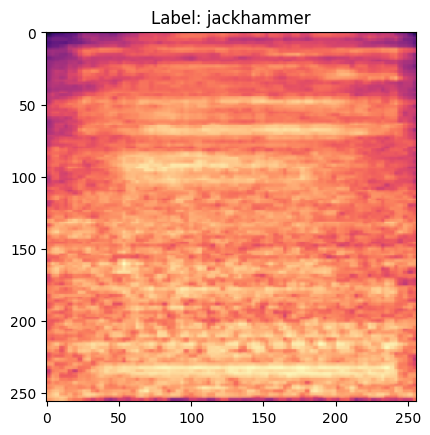

In [23]:
# Get a batch of training data from the DataLoader
# This retrieves one batch of data, which includes images and their corresponding labels
example_test = next(iter(dm.train_dataloader()))

# Extract the first image and its label from the batch
# example_test[0] contains the images, and example_test[1] contains the labels
image, label = example_test[0][0], example_test[1][0]

# Remove normalization from the image to convert it back to its original form
# This is done by reversing the normalization process applied during preprocessing
# Multiply by the standard deviation and add the mean for each channel (RGB)
image = image * torch.tensor([0.229, 0.224, 0.225]).view(3, 1, 1) + torch.tensor(
    [0.485, 0.456, 0.406]
).view(3, 1, 1)

# Display the image along with its label
# The label is converted from an integer to a string using the int_to_label dictionary
display_image_with_label(image, int_to_label[int(label)])

In [24]:
class ResNet34ImprovedModel(L.LightningModule):
    def __init__(self, lr, num_classes, pretrained, **kwargs):
        super().__init__()
        self.lr = lr
        self.num_classes = num_classes

        # Load the ResNet34 model with pre-trained weights if specified
        self.model = torchvision.models.resnet34(pretrained=pretrained)

        # Replace the final fully connected layer to match our number of classes
        self.model.fc = nn.Linear(self.model.fc.in_features, num_classes)

        # Initialize metrics for binary or multiclass classification
        task = "binary" if self.num_classes == 2 else "multiclass"
        self.accuracy = torchmetrics.Accuracy(task=task, num_classes=self.num_classes)
        self.f1 = torchmetrics.F1Score(task=task, num_classes=self.num_classes)

    def forward(self, x: torch.Tensor) -> torch.Tensor:
        return self.model(x)

    def training_step(
        self, batch: Tuple[torch.Tensor, torch.Tensor], batch_idx: int
    ) -> torch.Tensor:
        inputs, labels = batch
        logits = self(inputs)
        loss = F.cross_entropy(logits, labels)

        # Log the training loss
        self.log(
            "train_loss",
            loss,
            on_step=True,
            on_epoch=True,
            logger=True,
            sync_dist=True,
            prog_bar=True,
        )
        return loss

    def validation_step(
        self, batch: Tuple[torch.Tensor, torch.Tensor], batch_idx: int
    ) -> None:
        inputs, labels = batch
        logits = self(inputs)
        loss = F.cross_entropy(logits, labels)
        preds = torch.argmax(logits, dim=1)

        # Update metrics
        self.accuracy.update(preds, labels)
        self.f1.update(preds, labels)

        # Log the validation loss
        self.log(
            "val_loss",
            loss,
            on_step=True,
            on_epoch=True,
            logger=True,
            sync_dist=True,
            prog_bar=True,
        )

    def test_step(
        self, batch: Tuple[torch.Tensor, torch.Tensor], batch_idx: int
    ) -> None:
        # Test step is identical to validation step
        self.validation_step(batch, batch_idx)

    def on_validation_epoch_end(self):
        # Log and reset metrics at the end of validation epoch
        self.log(
            "val/acc",
            self.accuracy.compute(),
            sync_dist=True,
            on_step=False,
            on_epoch=True,
            logger=True,
            prog_bar=True,
        )
        self.log(
            "val/f1",
            self.f1.compute(),
            sync_dist=True,
            on_step=False,
            on_epoch=True,
            logger=True,
            prog_bar=True,
        )
        self.accuracy.reset()
        self.f1.reset()

    def on_test_epoch_end(self):
        # Test epoch end is identical to validation epoch end
        self.on_validation_epoch_end()

    def configure_optimizers(self):
        optimizer = torch.optim.AdamW(self.model.parameters(), lr=self.lr)

        # Configure the learning rate scheduler
        scheduler = torch.optim.lr_scheduler.OneCycleLR(
            optimizer,
            max_lr=self.lr,
            total_steps=self.trainer.estimated_stepping_batches,
            three_phase=False,
        )

        return [optimizer], [{"scheduler": scheduler, "interval": "step"}]

> ### New Features Added
>
> - **Metrics Calculation at Epoch End:**
>   - Implemented routines to calculate key performance metrics during the `on_validation_epoch_end` and `on_test_epoch_end` phases. This ensures that we can monitor our model's performance on both validation and test datasets after each epoch, providing valuable insights into its training progress.
>
> - **Adjustable Learning Rate:**
>   - Introduced an adjustable learning rate feature, allowing for more control over the training process. An appropriate learning rate is crucial for efficient training and convergence of neural networks.
>
> - **Learning Rate Scheduler:**
>   - Integrated a [learning rate scheduler](https://pytorch.org/docs/stable/optim.html#module-torch.optim.lr_scheduler) to dynamically adjust the learning rate during training. Specifically, we are using the [One Cycle LR Scheduler](https://pytorch.org/docs/stable/generated/torch.optim.lr_scheduler.OneCycleLR.html#torch.optim.lr_scheduler.OneCycleLR).
>
> ### One Cycle LR Scheduler
>
> The One Cycle Learning Rate (LR) Scheduler follows a unique policy known as the 1cycle policy. Here's how it works:
>
> - **Initial Phase:** The learning rate starts from an initial value and gradually increases to reach a maximum learning rate.
> - **Peak Phase:** After reaching the peak, the learning rate then diminishes from this maximum value to a minimum learning rate, which is significantly lower than the initial learning rate.
>
> This strategy helps in achieving faster and more stable training results, as described in the paper [Super-Convergence: Very Fast Training of Neural Networks Using Large Learning Rates](https://arxiv.org/abs/1708.07120). By following this policy, models often converge faster and potentially achieve better generalization.
>
> With these new features, our model training process becomes more robust and flexible. Calculating metrics at the end of each validation and test epoch provides critical evaluation checkpoints, while the adjustable learning rate and dynamic scheduling through the One Cycle LR Scheduler enhance the efficiency and effectiveness of the training regimen. These enhancements align with advanced training techniques that promote quicker convergence and superior model performance.

In [25]:
# Define hyperparameters for the model
hparams = Namespace(
    lr=1e-3,  # Learning rate
    num_classes=len(label_to_int),  # Number of classes based on the dataset
    pretrained=True,  # Use pretrained weights for the ResNet34 backbone
)

# Initialize WandB logger for experiment tracking
wandb_logger = L.pytorch.loggers.WandbLogger(project="UrbanSound8K")
wandb_logger.log_hyperparams(hparams)

# Create the ResNet34 model with custom improvements
model = ResNet34ImprovedModel(**vars(hparams))

# Set up model checkpoint callback to save the best model
checkpoint_callback = L.pytorch.callbacks.ModelCheckpoint(
    monitor="val_loss",  # Monitor validation loss
    dirpath="checkpoints",  # Directory to save checkpoints
    filename="resnet34_pretrained_UrbanSound8KDataset-{epoch:02d}-{val_loss:.2f}",
    save_top_k=1,  # Save only the best model
    mode="min",  # Lower validation loss is better
)

# Set up learning rate monitor callback
lr_monitor_callback = L.pytorch.callbacks.LearningRateMonitor(
    logging_interval="step", log_momentum=True, log_weight_decay=True
)

# Initialize the PyTorch Lightning Trainer
trainer = L.pytorch.Trainer(
    max_epochs=10,  # Train for 10 epochs
    devices=1,  # Use 1 GPU
    precision=16,  # Use mixed precision training for faster computation
    callbacks=[checkpoint_callback, lr_monitor_callback],  # Add callbacks
    logger=wandb_logger,  # Use WandB for logging
    log_every_n_steps=1,  # Log metrics every step
)

wandb: Using wandb-core as the SDK backend.  Please refer to https://wandb.me/wandb-core for more information.
wandb: Currently logged in as: eliasjacob. Use `wandb login --relogin` to force relogin


/home/jacob/.cache/pypoetry/virtualenvs/deep-learning-gen-ai-vEhrekpc-py3.12/lib/python3.12/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/home/jacob/.cache/pypoetry/virtualenvs/deep-learning-gen-ai-vEhrekpc-py3.12/lib/python3.12/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet34_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet34_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
/home/jacob/.cache/pypoetry/virtualenvs/deep-learning-gen-ai-vEhrekpc-py3.12/lib/python3.12/site-packages/lightning/fabric/connector.py:571: `precision=16` is supported for historical reasons but its usage is discouraged. Please set your precisi

> ### New Features Added
>
> #### 1. Learning Rate (LR) Monitor Callback
>
> **Purpose:**
> The LR Monitor Callback is designed to track and log the learning rate progression throughout the training process of a machine learning model.
>
> **Benefits:**
> - **Insight into Model Training:** Monitoring the learning rate allows us to observe how it changes during training. This can offer insights into whether the rate is too high or too low at different stages.
> - **Debugging:** If something goes wrong with the model training, understanding the learning rate behavior can help pinpoint the issue.
> - **Optimization:** Adjusting the learning rate appropriately can significantly enhance the model's performance and convergence speed.
>
> Since we aren't using a fixed learning rate anyumore, If a model's performance plateaus or starts to degrade, checking the logged learning rates might reveal that the current rate is inappropriate for the given epoch or iteration, prompting adjustments.
>
> ---
>
> #### 2. Weights & Biases (WandB) Logger
>
> **Purpose:**
> The WandB Logger integrates our machine learning framework with [Weights & Biases](https://www.wandb.com/), an industry-standard tool for experiment tracking, model visualization, and hyperparameter analysis.
>
> **Benefits:**
> - **Real-time Visualization:** Get real-time feedback on metrics such as loss, accuracy, and other custom parameters via live dashboards.
> - **Thorough Experiment Tracking:** Logs detailed information on every run, including configurations, system metrics, and more.
> - **Collaboration & Sharing:** Facilitates sharing results and visualizations with team members or stakeholders easily.
> - **Comparative Analysis:** Simplifies comparing multiple runs, models, and hyperparameters to identify the best-performing configurations.
>
> When you are experimenting with different architectures or hyperparameters, WandB helps in identifying which combination yields the best results by providing detailed logs and visual comparisons.
>
> ---
>
> #### 3. Hyperparameters as NameSpace
>
> **Purpose:**
> Organize hyperparameters using a `NameSpace` class structure instead of hard-coding them directly within scripts.
>
> **Benefits:**
> - **Code Clarity:** Grouping hyperparameters logically makes the code easier to read and maintain.
> - **Ease of Management:** Simplifies the process of adjusting hyperparameters by centralizing their definitions.
> - **Reproducibility:** Ensures consistent configuration across different runs, which is crucial for reproducibility and debugging.
> - **Avoids Hard-Coding Pitfalls:** Reduces the risk of errors that arise from scattering hyperparameter values throughout the codebase.
>
> While running multiple experiments, having all hyperparameters defined within a `NameSpace` ensures that changing a single value doesn’t require searching through the entire codebase, making the modification process efficient and reducing errors.

In [26]:
# Use the PyTorch Lightning tuner to find the optimal learning rate
# This helps in identifying the best learning rate for training the model, which can improve convergence and performance

# Initialize the learning rate finder using the trainer and model
# The lr_find method runs a short training loop to find the optimal learning rate
lr_finder = L.pytorch.tuner.Tuner(trainer).lr_find(model, dm)

# Print the suggested learning rate found by the tuner
# The suggestion method returns the learning rate that is considered optimal based on the training results
print(f"Suggested LR: {lr_finder.suggestion()}")

You are using a CUDA device ('NVIDIA GeForce RTX 3090') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
/home/jacob/.cache/pypoetry/virtualenvs/deep-learning-gen-ai-vEhrekpc-py3.12/lib/python3.12/site-packages/lightning/pytorch/callbacks/model_checkpoint.py:654: Checkpoint directory /media/nas-elias/drive/UFRN/Disciplinas/2024-2/deep_learning_gen_ai/checkpoints exists and is not empty.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0,1]
Loading `train_dataloader` to estimate number of stepping batches.


Finding best initial lr:   0%|          | 0/100 [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_steps=100` reached.
Learning rate set to 0.000630957344480193
Restoring states from the checkpoint path at /media/nas-elias/drive/UFRN/Disciplinas/2024-2/deep_learning_gen_ai/.lr_find_659041e8-e565-4681-9a4b-9adee377f732.ckpt
Restored all states from the checkpoint at /media/nas-elias/drive/UFRN/Disciplinas/2024-2/deep_learning_gen_ai/.lr_find_659041e8-e565-4681-9a4b-9adee377f732.ckpt


Suggested LR: 0.000630957344480193


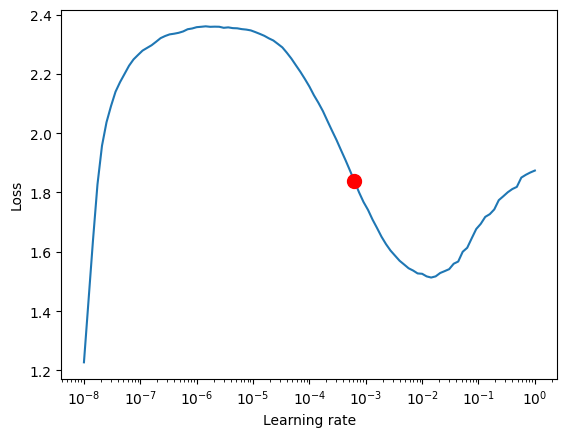

In [27]:
# Plot the learning rate finder results
# This visualizes the loss as a function of the learning rate, helping to identify the optimal learning rate
fig = lr_finder.plot(suggest=True)

# Save the plot to a buffer in PNG format
# This allows the plot to be saved in memory rather than directly to a file
img_buf = io.BytesIO()
fig.savefig(img_buf, format="png")

# Display the plot
# This shows the plot in the notebook, making it easier to interpret the results
plt.show(fig)

In [28]:
# Open the image from the buffer
# This reads the plot image from the in-memory buffer where it was saved
fig = Image.open(img_buf)

# Log the learning rate finder plot to Weights and Biases (wandb)
# key: The key under which the image will be logged
# images: List of images to log (in this case, just the LR finder plot)
# caption: List of captions for the images
wandb_logger.log_image(key="lr_finder", images=[fig], caption=["LR Finder"])

# Update the learning rate in the hyperparameters
# This sets the learning rate to the value suggested by the learning rate finder
hparams.lr = lr_finder.suggestion()

# Update the learning rate in the model
# This ensures that the model uses the new learning rate for training
model.lr = hparams.lr

In [29]:
model.lr

0.000630957344480193

> ### New Features Added
>
> #### Learning Rate Finder
>
> **Purpose:**
>
> The selection of a suitable learning rate is essential for effectively training deep neural networks, as it significantly influences both performance and the speed of convergence. Even adaptive optimizers like Adam, which automatically adjust the learning rate, can benefit from starting with an optimal learning rate.
>
> To streamline the process of choosing a good initial learning rate, we utilize a tool known as the **Learning Rate Finder**. This approach reduces guesswork and is well-detailed in [this paper](https://arxiv.org/abs/1506.01186).
>
> **How It Works:**
>
> 1. **Short Training Run:** The learning rate finder performs a brief training run where the learning rate is systematically increased after each processed batch.
> 2. **Logging Loss:** Throughout this run, the corresponding loss values are logged.
> 3. **Generating Plot:** The recorded data is then used to generate a **learning rate vs. loss plot**.
>
> **Interpreting the Results:**
>
> - The generated plot provides a visual representation that helps in selecting an optimal initial learning rate.
> - A common heuristic is to choose a learning rate that is approximately one order of magnitude (10x) lower than the learning rate at which the minimum loss is observed on the plot.
> - There are several algorithms to suggest an ideal learning rate, you can check them [here](https://docs.fast.ai/callback.schedule.html). The one implemented in PyTorch Lightning is called "steep", which suggests a learning rate when the slope is the steepest. The default option for Fast.AI is called "valley", that takes the steepest slope roughly 2/3 through the longest valley in the LR plot. As an example, see the different selections in the image below
>
> <p align="center">
> <img src="images/lr_finder.png" alt="" style="width: 50%; height: 50%"/>
> </p>
>
> By following these guidelines, you can more effectively tune your neural network's learning rate, leading to better performance and faster convergence.

In [30]:
trainer.fit(model, dm)

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0,1]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name     | Type               | Params | Mode 
--------------------------------------------------------
0 | model    | ResNet             | 21.3 M | train
1 | accuracy | MulticlassAccuracy | 0      | train
2 | f1       | MulticlassF1Score  | 0      | train
--------------------------------------------------------
21.3 M    Trainable params
0         Non-trainable params
21.3 M    Total params
85.159    Total estimated model params size (MB)
118       Modules in train mode
0         Modules in eval mode


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


In [31]:
print(f"Best model path: {checkpoint_callback.best_model_path}")

Best model path: /media/nas-elias/drive/UFRN/Disciplinas/2024-2/deep_learning_gen_ai/checkpoints/resnet34_pretrained_UrbanSound8KDataset-epoch=06-val_loss=0.05.ckpt


In [32]:
# WandB site for this run
print(f"URL for this run: {wandb_logger.experiment.url}")

URL for this run: https://wandb.ai/eliasjacob/UrbanSound8K/runs/yesac2uw


In [33]:
# Reload the best model from the checkpoint
# This loads the model weights from the checkpoint file where the best model (based on validation loss) was saved
# checkpoint_callback.best_model_path contains the path to the best model checkpoint
# **vars(hparams) passes the hyperparameters to the model
model = ResNet34ImprovedModel.load_from_checkpoint(
    checkpoint_callback.best_model_path, **vars(hparams)
)

# Test the best model on the test set
# This evaluates the model's performance on the test dataset using the trainer's test method
# datamodule=dm specifies the data module to use for loading the test data
trainer.test(model, datamodule=dm)

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0,1]


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│          val/acc          │    0.9734432101249695     │
│          val/f1           │    0.9734432101249695     │
│      val_loss_epoch       │    0.07813241332769394    │
└───────────────────────────┴───────────────────────────┘

[{'val_loss_epoch': 0.07813241332769394,
  'val/acc': 0.9734432101249695,
  'val/f1': 0.9734432101249695}]

>
> As you just saw, image classification can be applied to a wide range of problems beyond its traditional boundaries. In this notebook, we used image classification to classify sounds by turning them into visual representations. Let's explore some other innovative examples from the FastAI book that illustrate the versatility and power of image classification.
>
> #### Example 1: Time Series Data
>
> A time series can be converted into an image by plotting the data on a graph. By choosing appropriate transformations, you can highlight important features like seasonality and anomalies. One technique is the **Gramian Angular Difference Field (GADF)**, which was employed by FastAI student Ignacio Oguiza for olive oil classification. Despite having only 30 training images, this method achieved over 90% accuracy, close to state-of-the-art results.
>
> <img alt="Converting a time series into an image" width="700" caption="Converting a time series into an image" id="ts_image" src="images/att_00013.png">
>
> #### Example 2: Fraud Detection with Mouse Movement
>
> Gleb Esman, another FastAI student, tackled fraud detection at Splunk using users' mouse movements and clicks. He transformed these actions into images where the position, speed, and acceleration were represented by colored lines, and clicks by [small colored circles](https://www.splunk.com/en_us/blog/security/deep-learning-with-splunk-and-tensorflow-for-security-catching-the-fraudster-in-neural-networks-with-behavioral-biometrics.html). This image representation fed into an image recognition model led to effective fraud detection and even resulted in a patent.
>
> <img alt="Converting computer mouse behavior to an image" width="450" caption="Converting computer mouse behavior to an image" id="splunk" src="images/att_00014.png">
>
> #### Example 3: Malware Detection
>
> In the paper ["Malware Classification with Deep Convolutional Neural Networks"](https://ieeexplore.ieee.org/abstract/document/8328749) by Mahmoud Kalash et al., malware binary files were divided into 8-bit sequences and converted into decimal values. These values were then reshaped into gray-scale images representing different malware samples. The resulting images helped create a model that was more accurate than any previous approach in academic literature.
>
> <img alt="Malware classification process" width="623" caption="Malware classification process" id="malware_proc" src="images/att_00055.png">
> <img alt="Malware examples" width="650" caption="Malware examples" id="malware_eg" src="images/att_00056.png">
>
>
> That's all to show that a small number of general approaches in deep learning can be highly effective when creatively applied to various types of data. These examples demonstrate that transforming data into images is not just a workaround but often the most efficient way to achieve superior results.

-----

# Object Detection


Object detection is a task in computer vision that involves identifying and locating objects within an image or video. Unlike image classification, which assigns a single label to an entire image, object detection provides both the class of the objects and their precise locations via bounding boxes.

Object detection is essential for many applications, such as autonomous driving, video surveillance, face recognition, and robotics. Understanding the positions and categories of multiple objects allows systems to interact with their environment more intelligently and effectively.

## Key Techniques and Models

1. **R-CNN (Region-Based Convolutional Neural Networks)**
    - **Description**: R-CNN is one of the pioneering techniques in the field of object detection. It first generates region proposals using selective search and then classifies each region using a convolutional neural network.
    - **Pros and Cons**:
        - Pros: High accuracy, strong foundation for future models.
        - Cons: Slow due to the separate region proposal and classification stages.

2. **Fast R-CNN**
    - **Description**: An improvement over R-CNN where the region proposals are fed into a CNN just once, and features are extracted for each proposal using RoI pooling.
    - **Pros and Cons**:
        - Pros: Faster than R-CNN, end-to-end training.
        - Cons: Still involves a separate step for generating region proposals.

3. **Faster R-CNN**
    - **Description**: Addresses the speed bottleneck by introducing a Region Proposal Network (RPN) that shares full-image convolutional features with the detection network, allowing almost cost-free region proposals.
    - **Pros and Cons**:
        - Pros: Significantly faster than its predecessors, high accuracy.
        - Cons: Complexity in training the combined network.

4. **YOLO (You Only Look Once)**
    - **Description**: YOLO divides the image into a grid and predicts bounding boxes and probabilities for each grid cell simultaneously, making it extremely fast.
    - **Pros and Cons**:
        - Pros: Real-time detection, simplicity.
        - Cons: Lower accuracy for small objects and close objects compared to R-CNN variants.

5. **SSD (Single Shot Multibox Detector)**
    - **Description**: SSD uses a single deep neural network to predict multiple bounding boxes and class probabilities directly, without requiring region proposals.
    - **Pros and Cons**:
        - Pros: Balances speed and accuracy, suitable for real-time applications.
        - Cons: Performance may drop on small objects compared to two-stage methods like Faster R-CNN.

6. **Mask R-CNN**
    - **Description**: An extension of Faster R-CNN that adds a branch for predicting segmentation masks on each Region of Interest (RoI).
    - **Pros and Cons**:
        - Pros: Capable of instance segmentation, high accuracy.
        - Cons: Slower than Faster R-CNN due to the additional mask prediction branch.

## Applications in Real-World Scenarios

- **Autonomous Driving**: Object detection is used to identify pedestrians, vehicles, traffic signs, and obstacles, enabling safe navigation through complex environments.

- **Video Surveillance**: Detecting suspicious activities, tracking individuals, and recognizing faces in security footage help enhance safety and monitoring efficiency.

- **Healthcare**: Identifying and localizing abnormalities in medical images such as X-rays, MRIs, and CT scans can assist in diagnosis and treatment planning.

- **Retail and E-commerce**: Object detection aids in automatic inventory management, identifying products on shelves, and enhancing customer experience through augmented reality applications.

<br>

> Let's see a basic implementation of object detection using [Mask R-CNN](https://arxiv.org/abs/1703.06870)

## The Dataset

The [CPPE-5 dataset](https://huggingface.co/datasets/cppe-5) is specifically curated to address the identification and annotation of medical personnel's protective equipment (PPE) during the COVID-19 pandemic. This dataset includes images that are meticulously annotated to highlight various types of PPE worn by healthcare workers.

### Key Features of the CPPE-5 Dataset

1. **Focus on Medical PPE**: Designed to identify different kinds of personal protective equipment, such as masks, gloves, face shields, gowns, and other vital gear used in medical settings.

2. **Contextual Relevance**: Reflects real-world scenarios from the COVID-19 pandemic, making it highly relevant for developing applications aimed at improving safety and compliance in healthcare environments.

3. **Annotations**: Each image in this dataset comes with annotations that specify the type and location of PPE within the image. These annotations are crucial for training machine learning models to recognize and classify PPE effectively.

### Getting Started

To begin working with the CPPE-5 dataset, start by loading it into your environment. It’s essential to understand how to access and prepare the data for training and evaluating your machine learning models.

In [34]:
# Load the CPPE-5 dataset using the Hugging Face datasets library
# The "cppe-5" dataset is a dataset for personal protective equipment detection
# datasets.load_dataset is a function that fetches the dataset from the Hugging Face Hub
cppe5 = datasets.load_dataset("cppe-5")

# Display the dataset object
# This shows the structure and contents of the dataset, including the splits (train, validation, test)
cppe5

README.md:   0%|          | 0.00/11.2k [00:00<?, ?B/s]

train-00000-of-00001.parquet:   0%|          | 0.00/237M [00:00<?, ?B/s]

test-00000-of-00001.parquet:   0%|          | 0.00/4.14M [00:00<?, ?B/s]

Generating train split:   0%|          | 0/1000 [00:00<?, ? examples/s]

Generating test split:   0%|          | 0/29 [00:00<?, ? examples/s]

DatasetDict({
    train: Dataset({
        features: ['image_id', 'image', 'width', 'height', 'objects'],
        num_rows: 1000
    })
    test: Dataset({
        features: ['image_id', 'image', 'width', 'height', 'objects'],
        num_rows: 29
    })
})

In [35]:
cppe5["train"][0]

{'image_id': 15,
 'image': <PIL.Image.Image image mode=RGB size=943x663>,
 'width': 943,
 'height': 663,
 'objects': {'id': [114, 115, 116, 117],
  'area': [3796, 1596, 152768, 81002],
  'bbox': [[302.0, 109.0, 73.0, 52.0],
   [810.0, 100.0, 57.0, 28.0],
   [160.0, 31.0, 248.0, 616.0],
   [741.0, 68.0, 202.0, 401.0]],
  'category': [4, 4, 0, 0]}}

> The examples in the dataset contain several key fields that provide detailed metadata about each image and the objects within it. Here’s a breakdown of these fields:
>
> ### Main Fields in the Dataset
>
> - **`image_id`**: A unique identifier for the example image.
> - **`image`**: Contains the image itself as a `PIL.Image.Image` object, enabling easy manipulation and visualization using Python's Pillow library.
> - **`width`**: The width of the image in pixels.
> - **`height`**: The height of the image in pixels.
> - **`objects`**: A dictionary that contains metadata related to the various objects present in the image.
>
> ### Fields within the `objects` Dictionary
>
> - **`id`**: Unique identifier for the annotation.
> - **`area`**: The area of the bounding box, which provides a measure of the size of the object within the image.
> - **`bbox`**: The bounding box coordinates that outline the object, formatted according to the [COCO format](https://albumentations.ai/docs/getting_started/bounding_boxes_augmentation/#coco). This format includes four values: `(x_min, y_min, width, height)`.
> - **`category`**: The category of the object identified in the image. Possible values and their corresponding numerical labels are:
> - `Coverall (0)`
> - `Face_Shield (1)`
> - `Gloves (2)`
> - `Goggles (3)`
> - `Mask (4)`
>
> ### Important Note on Data Format
>
> You may notice that the `bbox` field follows the COCO format, which is the standard input format for many models, including the DETR model. However, the grouping of fields inside the `objects` dictionary differs from what the DETR model expects for annotations. Therefore, you will need to perform some data preprocessing transformations to align this data with the specific requirements of your chosen model.
>
> ### Visualization
>
> To gain a deeper understanding of the dataset and its structure, it's highly beneficial to visualize an example from the dataset. Visualization can help you see how the bounding boxes and categories are applied to real images, making the abstract data fields more tangible and easier to understand.
>

In [36]:
# Get the category names from the dataset features
category_names = cppe5["test"].features["objects"].feature["category"].names

# Create mappings between category IDs and category names
id_to_label = {index: name for index, name in enumerate(category_names, start=0)}
label_to_id = {name: index for index, name in id_to_label.items()}

# Explanation of the mappings:
# id_to_label: Maps numeric IDs to category names (e.g., 0 -> 'Mask', 1 -> 'Gloves')
# label_to_id: Maps category names to numeric IDs (e.g., 'Mask' -> 0, 'Gloves' -> 1)

# These mappings are useful for:
# 1. Converting model predictions (typically numeric) to human-readable category names
# 2. Converting annotated labels (typically strings) to numeric IDs for model training

# Display the id_to_label dictionary to verify the mapping
id_to_label

{0: 'Coverall', 1: 'Face_Shield', 2: 'Gloves', 3: 'Goggles', 4: 'Mask'}

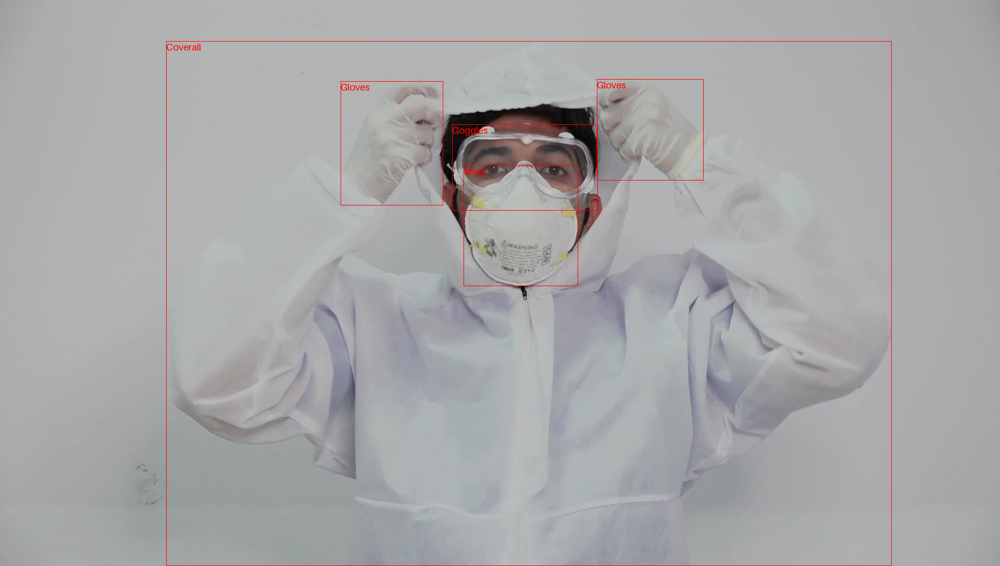

In [37]:
# Extract the first image from the test split of the CPPE-5 dataset
# cppe5["test"][0] accesses the first sample in the test split
# ["image"] retrieves the image data from the sample
image = cppe5["test"][0]["image"]

# Extract the annotations for the first image
# ["objects"] retrieves the list of detected objects in the image, including their bounding boxes and categories
annotations = cppe5["test"][0]["objects"]

# Display the image with bounding boxes
# show_image_with_bbox is a function that takes an image and its annotations
# It visualizes the image and overlays the bounding boxes with labels
show_image_with_bbox(image, annotations)

> ### Removing Data with Potential Issues
>
> As a final step in familiarizing yourself with the dataset, it is important to explore the data for potential issues that could affect the performance of your model during training. One common problem encountered in datasets for object detection is the presence of bounding boxes that extend beyond the edge of the image.
>
> #### Understanding "Runaway" Bounding Boxes
> - **Runaway Bounding Boxes**: These are bounding boxes where one or more edges exceed the image boundaries. Such bounding boxes can cause errors during the training process and compromise the effectiveness of your model.
>
> ### Identifying and Handling the Issue
> In this dataset, there are a few examples where bounding boxes stretch beyond the image edges. To maintain the integrity of your training data and to simplify our life, recommend removing these problematic images from the dataset. This ensures that your model training process runs smoothly without interruptions caused by invalid bounding boxes.
>
> ### Steps to Address the Issue
> 1. **Identify**: Scan the dataset to identify any images with bounding boxes extending beyond the image boundaries.
> 2. **Log or Document**: Keep track of how many and which specific images have this issue, as it provides insight into the quality and structure of the dataset.
> 3. **Remove**: Exclude these images from your dataset to prevent potential errors during training.
>

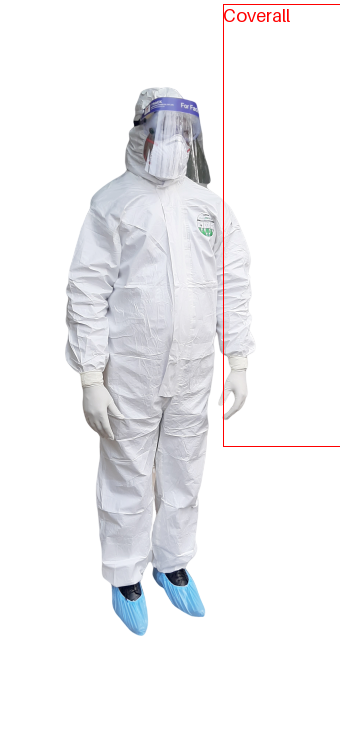

In [38]:
# Load one example of annotation problem
image = cppe5["train"][590]["image"]
annotations = cppe5["train"][590]["objects"]

show_image_with_bbox(image, annotations)

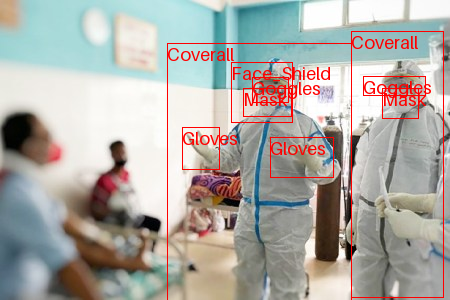

In [39]:
# Load one example of annotation problem
image = cppe5["train"][821]["image"]
annotations = cppe5["train"][821]["objects"]

show_image_with_bbox(image, annotations)

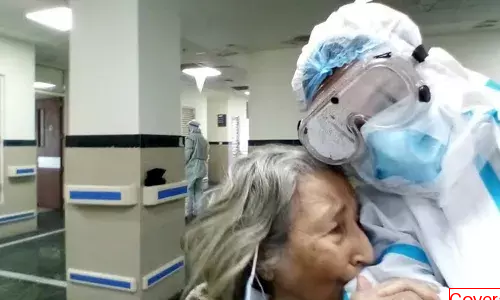

In [40]:
# Load one example of annotation problem
image = cppe5["train"][822]["image"]
annotations = cppe5["train"][822]["objects"]

show_image_with_bbox(image, annotations)

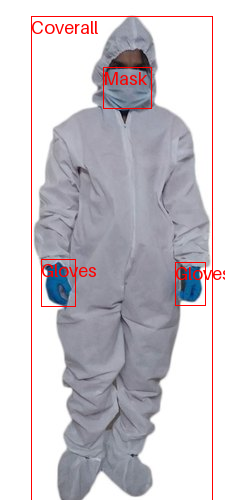

In [41]:
# Load one example of annotation problem
image = cppe5["train"][875]["image"]
annotations = cppe5["train"][875]["objects"]

show_image_with_bbox(image, annotations)

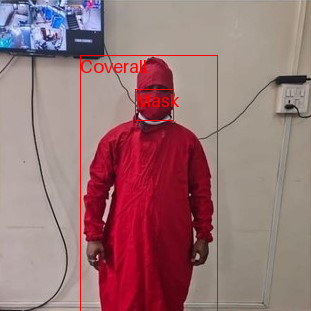

In [42]:
# Load one example of annotation problem
image = cppe5["train"][876]["image"]
annotations = cppe5["train"][876]["objects"]

show_image_with_bbox(image, annotations)

In [43]:
# List of indices to be removed from the training dataset. These indices correspond to the examples with annotation problems.
remove_idx = [590, 821, 822, 875, 876, 878, 879]

# Create a list of indices to keep by excluding the indices in remove_idx
keep = [i for i in range(len(cppe5["train"])) if i not in remove_idx]

# Select the subset of the training dataset that excludes the specified indices
cppe5["train"] = cppe5["train"].select(keep)

In [44]:
cppe5["train"][0]  # Check the first example in the training dataset

{'image_id': 15,
 'image': <PIL.Image.Image image mode=RGB size=943x663>,
 'width': 943,
 'height': 663,
 'objects': {'id': [114, 115, 116, 117],
  'area': [3796, 1596, 152768, 81002],
  'bbox': [[302.0, 109.0, 73.0, 52.0],
   [810.0, 100.0, 57.0, 28.0],
   [160.0, 31.0, 248.0, 616.0],
   [741.0, 68.0, 202.0, 401.0]],
  'category': [4, 4, 0, 0]}}

In [45]:
np.array(cppe5["train"][0]["image"]).shape  # Check the shape of the image

(663, 943, 3)

In [46]:
class CPPE5Dataset(torch.utils.data.Dataset):
    def __init__(
        self,
        huggingface_dataset: datasets.arrow_dataset.Dataset,
        transforms: torchvision.transforms.v2.Compose,
    ) -> None:
        # Store the Hugging Face dataset and transforms for later use
        self.huggingface_dataset = huggingface_dataset
        self.transforms = transforms

    def __getitem__(self, index: int) -> Tuple[torch.Tensor, Dict[str, Any]]:
        # Load and process a single item from the dataset

        # Load the image and convert it to RGB
        image = self.huggingface_dataset[index]["image"].convert("RGB")

        # Extract relevant information from the dataset
        image_id = self.huggingface_dataset[index]["image_id"]
        labels = self.huggingface_dataset[index]["objects"]["category"]
        area = self.huggingface_dataset[index]["objects"]["area"]

        # Convert bounding box format from COCO to VOC
        bounding_boxes = convert_coco_to_voc(
            self.huggingface_dataset[index]["objects"]["bbox"]
        )

        # Get image dimensions and number of objects
        image_height = self.huggingface_dataset[index]["height"]
        image_width = self.huggingface_dataset[index]["width"]
        num_objects = len(labels)

        # Create placeholder masks (CPPE-5 doesn't provide segmentation masks)
        masks = torch.zeros((num_objects, image_height, image_width), dtype=torch.uint8)

        # Convert image to torchvision tensor
        image_tensor = torchvision.tv_tensors.Image(image)

        # Create a tensor for crowd instances (all set to 0 in this case)
        iscrowd = torch.zeros((num_objects,), dtype=torch.uint8)

        # Prepare the target dictionary with all necessary information
        target: Dict[str, Any] = {
            "boxes": torchvision.tv_tensors.BoundingBoxes(
                bounding_boxes,
                format="XYXY",
                canvas_size=torchvision.transforms.v2.functional.get_size(image_tensor),
            ),
            "labels": torch.tensor(labels),
            "image_id": image_id,
            "area": torch.tensor(area),
            "iscrowd": iscrowd,
            "masks": torchvision.tv_tensors.Mask(masks),
        }

        # Apply transformations if any are specified
        if self.transforms is not None:
            image_tensor, target = self.transforms(image_tensor, target)

        return image_tensor, target

    def __len__(self) -> int:
        # Return the total number of items in the dataset
        return len(self.huggingface_dataset)

### How to Assess the Quality of an Object Detection Model

One of the most popular metrics used for evaluating the performance of an object detection model is the **Intersection over Union (IoU)**. IoU quantifies how well the predicted bounding boxes align with the ground truth bounding boxes in computer vision tasks.

#### Understanding Intersection over Union (IoU)

The IoU metric measures the overlap between two areas: the predicted bounding box and the ground truth bounding box. It is calculated using the following steps:

1. **Intersection Area**:
    - Calculate the area where the predicted bounding box overlaps with the ground truth bounding box.

2. **Union Area**:
    - Calculate the total area covered by both the predicted bounding box and the ground truth bounding box.
    - This total area is computed as the sum of both bounding boxes' areas minus the intersection area (to avoid counting it twice).

3. **IoU Calculation**:
    - Divide the intersection area by the union area to obtain the IoU score.
    - The formula for IoU is:

$$ \text{IoU} = \frac{\text{Area of Intersection}}{\text{Area of Union}} $$

#### Interpreting the IoU Score

The IoU score ranges from 0 to 1, where:

- **IoU = 0**: There is no overlap between the predicted and ground truth bounding boxes.
- **IoU = 1**: There is a perfect overlap between the predicted and ground truth bounding boxes.

A higher IoU score indicates a better performance of the object detector. In practice, an IoU threshold is often set to determine whether a predicted bounding box is considered a true positive (correct detection) or a false positive (incorrect detection). Commonly used thresholds include 0.5, meaning that if IoU ≥ 0.5, the prediction is counted as a correct detection.

#### Visual Representation of IoU

Here's a visual representation of IoU for better understanding:

<p align="center">
<img src="images/iou.webp" alt="IoU Visualization" style="width: 40%; height: 40%"/>
</p>

In [47]:
class CPPE5DataModule(L.LightningDataModule):
    def __init__(
        self,
        huggingface_train_dataset: datasets.arrow_dataset.Dataset,
        huggingface_valid_dataset: datasets.arrow_dataset.Dataset,
        huggingface_test_dataset: datasets.arrow_dataset.Dataset,
        batch_size: int = 2,
        num_workers: int = 1,
    ) -> None:
        super().__init__()
        # Store the input parameters
        self.batch_size = batch_size
        self.num_workers = num_workers
        self.huggingface_train_dataset = huggingface_train_dataset
        self.huggingface_valid_dataset = huggingface_valid_dataset
        self.huggingface_test_dataset = huggingface_test_dataset

    def setup(self, stage: Optional[str] = None) -> None:
        # Create dataset objects for each split
        # Apply appropriate transformations based on whether it's training or not
        self.train_dataset = CPPE5Dataset(
            self.huggingface_train_dataset, get_transform(is_training=True)
        )
        self.valid_dataset = CPPE5Dataset(
            self.huggingface_valid_dataset, get_transform(is_training=False)
        )
        self.test_dataset = CPPE5Dataset(
            self.huggingface_test_dataset, get_transform(is_training=False)
        )

    def collate_fn(self, batch):
        # Custom collate function to handle batching of data
        # This function organizes the batch data into a format suitable for the model
        return tuple(zip(*batch))

    def train_dataloader(self) -> torch.utils.data.DataLoader:
        # Create and return the DataLoader for training data
        return torch.utils.data.DataLoader(
            self.train_dataset,
            batch_size=self.batch_size,
            shuffle=True,  # Shuffle training data for better generalization
            num_workers=self.num_workers,
            collate_fn=self.collate_fn,
        )

    def val_dataloader(self) -> torch.utils.data.DataLoader:
        # Create and return the DataLoader for validation data
        return torch.utils.data.DataLoader(
            self.valid_dataset,
            batch_size=self.batch_size,
            shuffle=False,  # No need to shuffle validation data
            num_workers=self.num_workers,
            collate_fn=self.collate_fn,
        )

    def test_dataloader(self) -> torch.utils.data.DataLoader:
        # Create and return the DataLoader for test data
        return torch.utils.data.DataLoader(
            self.test_dataset,
            batch_size=self.batch_size,
            shuffle=False,  # No need to shuffle test data
            num_workers=self.num_workers,
            collate_fn=self.collate_fn,
        )

In [55]:
class MaskRCNNModule(L.LightningModule):
    def __init__(self, lr: float, num_classes: int, **kwargs: Any) -> None:
        super().__init__()
        self.lr = lr
        self.num_classes = num_classes
        self.model = get_instance_segmentation_model(
            num_classes
        )  # Load the Mask R-CNN model
        self.iou_metric = torchmetrics.detection.iou.IntersectionOverUnion()

    def forward(
        self, images: torch.Tensor, targets: Dict[str, Any] = None
    ) -> Dict[str, Any]:
        # During training (when targets are provided), return losses
        if targets:
            self.model.train()
            return self.model(images, targets)
        # During inference (no targets), return predictions
        else:
            self.model.eval()
            return self.model(images)

    def training_step(
        self, batch: Tuple[torch.Tensor, torch.Tensor], batch_idx: int
    ) -> torch.Tensor:
        images, targets = batch
        loss_dict = self.forward(images, targets)
        loss = sum(loss for loss in loss_dict.values())
        # Log the training loss
        self.log(
            f"train_loss",
            loss,
            on_step=True,
            on_epoch=True,
            logger=True,
            sync_dist=True,
            prog_bar=True,
        )
        return loss

    def validation_step(
        self, batch: Tuple[torch.Tensor, torch.Tensor], batch_idx: int
    ) -> None:
        images, targets = batch
        # Compute loss
        loss_dict = self.forward(images, targets)
        loss = sum(loss for loss in loss_dict.values())
        # Get predictions
        preds = self.forward(images)
        # Update IoU metric
        self.iou_metric.update(preds, targets)
        # Log validation loss
        self.log(
            f"val_loss",
            loss,
            on_step=True,
            on_epoch=True,
            logger=True,
            sync_dist=True,
            prog_bar=True,
        )

    def test_step(
        self, batch: Tuple[torch.Tensor, torch.Tensor], batch_idx: int
    ) -> None:
        # Similar to validation step
        images, targets = batch
        loss_dict = self.forward(images, targets)
        loss = sum(loss for loss in loss_dict.values())
        preds = self.forward(images)
        self.iou_metric.update(preds, targets)
        self.log(
            f"test_loss",
            loss,
            on_step=True,
            on_epoch=True,
            logger=True,
            sync_dist=True,
            prog_bar=True,
        )

    def on_validation_epoch_end(self) -> None:
        # Compute and log IoU at the end of validation epoch
        iou = self.iou_metric.compute()["iou"]
        self.log(
            f"val/iou",
            iou,
            sync_dist=True,
            on_step=False,
            on_epoch=True,
            logger=True,
            prog_bar=True,
        )
        self.iou_metric.reset()

    def on_test_epoch_end(self) -> None:
        # Compute and log IoU at the end of test epoch
        iou = self.iou_metric.compute()["iou"]
        self.log(
            f"test/iou",
            iou,
            sync_dist=True,
            on_step=False,
            on_epoch=True,
            logger=True,
            prog_bar=True,
        )
        self.iou_metric.reset()

    def configure_optimizers(
        self,
    ) -> Tuple[List[torch.optim.Optimizer], List[Dict[str, Any]]]:
        # Use SGD optimizer with weight decay (L2 regularization)
        optimizer = torch.optim.SGD(
            self.model.parameters(), lr=self.lr, weight_decay=1e-3
        )
        # Use OneCycleLR scheduler for learning rate adjustment
        scheduler = torch.optim.lr_scheduler.OneCycleLR(
            optimizer,
            max_lr=self.lr,
            total_steps=self.trainer.estimated_stepping_batches,
            three_phase=False,
        )

        return [optimizer], [{"scheduler": scheduler, "interval": "step"}]

In [56]:
id_to_label

{0: 'Coverall', 1: 'Face_Shield', 2: 'Gloves', 3: 'Goggles', 4: 'Mask'}

In [57]:
dm = CPPE5DataModule(
    # Initialize the CPPE5DataModule with datasets from the Hugging Face cppe5 dataset
    huggingface_train_dataset=cppe5["train"],
    huggingface_valid_dataset=cppe5[
        "test"
    ],  # Using test dataset as validation for demonstration
    huggingface_test_dataset=cppe5["test"],
    # Set batch size for data loading
    # Smaller batch size (4) is used here, likely due to memory constraints or for demonstration
    batch_size=4,
    # Number of subprocesses to use for data loading
    # 8 workers can improve data loading speed, especially for larger datasets
    num_workers=8,
)

# Prepare the data module
dm.setup()

# After this setup, the data module is ready to be used with a PyTorch Lightning Trainer
# You can access the dataloaders using dm.train_dataloader(), dm.val_dataloader(), etc.

In [61]:
# Define hyperparameters for the model
hparams = Namespace(
    lr=5e-3,  # Learning rate
    num_classes=len(id_to_label),  # Number of classes based on the dataset
)

# Initialize WandB logger for experiment tracking
wandb_logger = L.pytorch.loggers.WandbLogger(project="CPPE-5")
wandb_logger.log_hyperparams(hparams)  # Log hyperparameters to WandB

# Create the Mask R-CNN model with specified hyperparameters
model = MaskRCNNModule(**vars(hparams))

# Set up model checkpoint callback
checkpoint_callback = L.pytorch.callbacks.ModelCheckpoint(
    monitor="val_loss",  # Monitor validation loss
    dirpath="checkpoints",  # Directory to save checkpoints
    filename="maskrcnn_cppe5-{epoch:02d}-{val_loss:.2f}",  # Filename format
    save_top_k=1,  # Save only the best model
    mode="min",  # Lower validation loss is better
)

# Set up learning rate monitor callback
lr_monitor_callback = L.pytorch.callbacks.LearningRateMonitor(
    logging_interval="step",  # Log LR at every step
    log_momentum=True,  # Log momentum if used
    log_weight_decay=True,  # Log weight decay if used
)

# Initialize the PyTorch Lightning Trainer
trainer = L.pytorch.Trainer(
    max_epochs=10,  # Train for 10 epochs
    devices=1,  # Use 1 GPU
    precision=16,  # Use mixed precision for faster training
    callbacks=[checkpoint_callback, lr_monitor_callback],  # Add callbacks
    logger=wandb_logger,  # Use WandB for logging
    log_every_n_steps=1,  # Log metrics at every step
)

Downloading: "https://download.pytorch.org/models/maskrcnn_resnet50_fpn_v2_coco-73cbd019.pth" to /home/jacob/.cache/torch/hub/checkpoints/maskrcnn_resnet50_fpn_v2_coco-73cbd019.pth
100%|██████████| 177M/177M [00:06<00:00, 29.2MB/s]
Using 16bit Automatic Mixed Precision (AMP)
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


In [62]:
trainer.fit(model, dm)

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0,1]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name       | Type                  | Params | Mode 
-------------------------------------------------------------
0 | model      | MaskRCNN              | 45.9 M | train
1 | iou_metric | IntersectionOverUnion | 0      | train
-------------------------------------------------------------
45.7 M    Trainable params
225 K     Non-trainable params
45.9 M    Total params
183.586   Total estimated model params size (MB)
240       Modules in train mode
0         Modules in eval mode


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

/home/jacob/.cache/pypoetry/virtualenvs/deep-learning-gen-ai-vEhrekpc-py3.12/lib/python3.12/site-packages/lightning/pytorch/utilities/data.py:78: Trying to infer the `batch_size` from an ambiguous collection. The batch size we found is 3. To avoid any miscalculations, use `self.log(..., batch_size=batch_size)`.


Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


In [63]:
print(f"Best model path: {checkpoint_callback.best_model_path}")

Best model path: /media/nas-elias/drive/UFRN/Disciplinas/2024-2/deep_learning_gen_ai/checkpoints/maskrcnn_cppe5-epoch=06-val_loss=0.44.ckpt


In [64]:
# WandB site for this run
print(f"URL for this run: {wandb_logger.experiment.url}")

URL for this run: https://wandb.ai/eliasjacob/UrbanSound8K/runs/yesac2uw


In [65]:
# Reload the best model from the checkpoint
model = MaskRCNNModule.load_from_checkpoint(
    checkpoint_callback.best_model_path, **vars(hparams)
)

In [66]:
# Test the trained model on the test dataset using the PyTorch Lightning Trainer
trainer.test(model, datamodule=dm)

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0,1]


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/iou          │    0.1647820919752121     │
│      test_loss_epoch      │    0.4496637284755707     │
└───────────────────────────┴───────────────────────────┘

[{'test_loss_epoch': 0.4496637284755707, 'test/iou': 0.1647820919752121}]

torch.Size([4, 676, 1012])
torch.Size([3, 676, 1012])


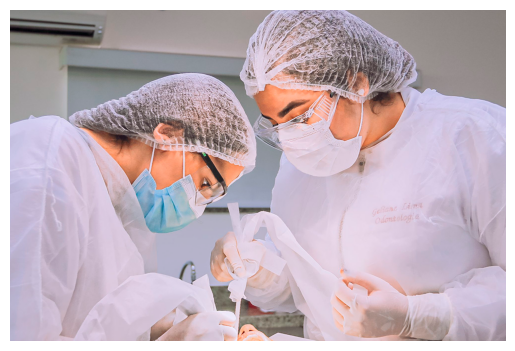

In [67]:
# Read the image from the specified file path
# This uses torchvision's image reading function, which returns a tensor
image = torchvision.io.image.read_image(
    "images/Capa-Aperfeicoamento-em-Cirurgia-e-Traumatologia-Bucomaxilofacial.png"
)

# Print the shape of the image tensor (should be [channels, height, width])
# This helps us understand the dimensions of the image
print(image.shape)

# Convert the image from RGBA (4 channels) to RGB (3 channels) by keeping only the first 3 channels
# This is often necessary as most image processing functions expect 3-channel RGB images
image = image[:3]

# Print the shape of the image tensor after conversion (should be [3, height, width])
# This confirms that we've successfully removed the alpha channel
print(image.shape)

# Remove x-axis and y-axis ticks from the plot
# This gives a cleaner look to the displayed image
plt.axis("off")

# Display the image using matplotlib
# Permute the dimensions from [channels, height, width] to [height, width, channels] for correct display
# This is necessary because matplotlib expects images in a different format than PyTorch tensors
plt.imshow(image.permute(1, 2, 0))
plt.show()

In [68]:
# Apply the evaluation transformation to the input image
eval_transform = get_transform(is_training=False)

# Set the model to evaluation mode
model.eval()

# Disable gradient calculation for inference
with torch.no_grad():
    # Ensure the image is in RGB format by keeping only the first three channels
    image = image[:3, ...]

    # Apply the evaluation transformation to the image
    x = eval_transform(image)

    # Move the image to the same device as the model
    x = x.to(model.device)

    # Get predictions from the model
    predictions = model(
        [
            x,
        ]
    )
    pred = predictions[0]

    # Keep only predictions with a score >= 0.5
    keep = pred["scores"] >= 0.5
    pred = {k: v[keep] for k, v in pred.items()}

# Normalize the image to the range [0, 255] and convert to uint8
image = (255.0 * (image - image.min()) / (image.max() - image.min())).to(torch.uint8)

# Generate labels for the predictions with their scores
pred_labels = [
    f"{id_to_label[int(i)]}: {s:.2f}" for i, s in zip(pred["labels"], pred["scores"])
]

# Display the prediction labels
pred_labels

['Mask: 0.99', 'Gloves: 0.98', 'Mask: 0.97', 'Mask: 0.91']

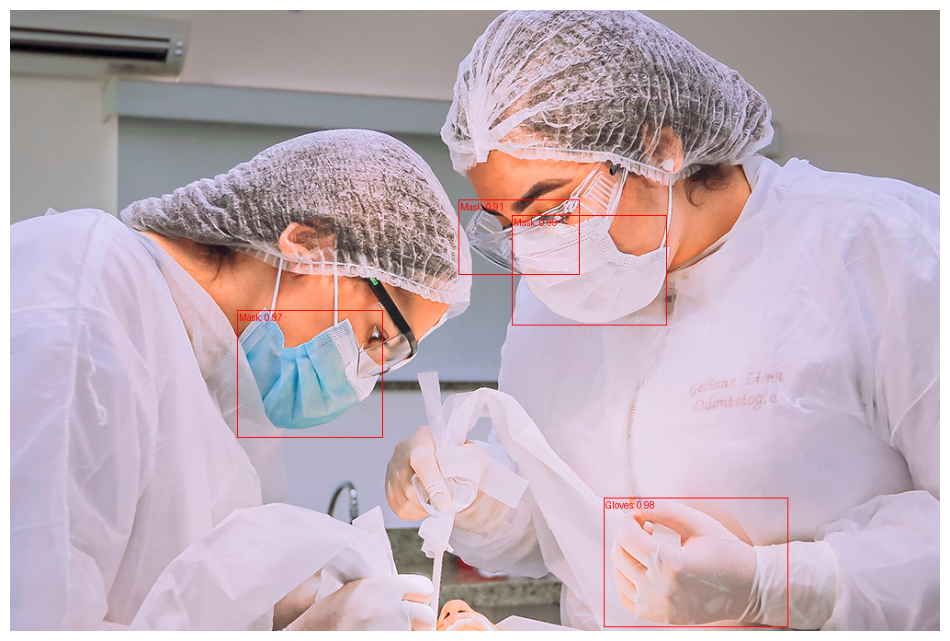

In [69]:
# Convert the predicted bounding boxes to long type and move them to the CPU
pred_boxes = pred["boxes"].long().cpu()

# Draw the bounding boxes on the image with the specified labels and color
output_image = torchvision.utils.draw_bounding_boxes(
    image, pred_boxes, pred_labels, colors="red"
)

# Create a new figure with a specified size
plt.figure(figsize=(12, 12))

# Remove x-axis and y-axis ticks from the plot
plt.axis("off")

# Display the image with bounding boxes using matplotlib
plt.imshow(
    output_image.permute(1, 2, 0)
)  # Permute the dimensions from [channels, height, width] to [height, width, channels] for correct display
plt.show()

## Wrapping Up

In this section, we explored the concept of object detection, a fundamental task in computer vision that involves identifying and locating objects within images. Object detection provides detailed information about the objects present in an image, including their categories and precise locations via bounding boxes.

### Key Points Covered

1. **Definition and Importance**: Object detection not only identifies what objects are in an image but also pinpoints their exact locations.

2. **Bounding Boxes**: These are rectangular boxes drawn around each detected object, allowing us to extract both the category and the position of the object from the image.

3. **Key Techniques and Models**
    - **R-CNN (Region-Based Convolutional Neural Networks)**
    - **YOLO (You Only Look Once)**
    - **Mask R-CNN**


In the next section, we'll shift our focus to another crucial aspect of understanding images: **image segmentation**. While object detection provides bounding boxes around objects, image segmentation goes a step further by dividing an image into segments or regions, which simplifies its representation and facilitates detailed analysis.


-----

# Image Segmentation

Image segmentation is a computer vision technique that partitions a digital image into discrete groups of pixels—image segments—to inform object detection and related tasks. By parsing an image’s complex visual data into specifically shaped segments, image segmentation enables faster, more advanced image processing.

## Applications of Image Segmentation

Image segmentation has a wide range of practical applications across various industries:

1. **Medical Imaging**: Identifying tumors, measuring organ dimensions
2. **Autonomous Vehicles**: Detecting road boundaries, obstacles, and traffic signs
3. **Satellite Imaging**: Mapping terrain, monitoring deforestation
4. **Facial Recognition**: Isolating facial features for analysis
5. **Augmented Reality**: Integrating virtual objects seamlessly with real-world scenes

## Image Segmentation vs. Object Detection vs. Image Classification

<p align="center">
<img src="images/image_segmentation_comparison.jpeg" style="width: 40%; height: 40%"/>
</p>


### Image Classification

Image classification applies a class label to an entire image. For example, a simple image classification model might be trained to categorize vehicle images as “car” or “truck”. Conventional image classification systems are limited in sophistication, as they do not process individual image features separately.

### Object Detection

Object detection combines image classification with object localization, generating rectangular regions, called “bounding boxes”, in which objects are located. Rather than merely labeling a vehicle image as “car” or “truck,” an object detection model could indicate where in the image the car(s) or truck(s) can be found. While object detection can classify multiple elements within an image and approximate each element’s width and height, it cannot discern precise boundaries or shapes. This limits the ability of conventional object detection models to delineate closely bunched objects with overlapping bounding boxes.

### Image Segmentation

Image segmentation processes visual data at the pixel level, using various techniques to annotate individual pixels as belonging to a specific class or instance. “Classic” image segmentation techniques determine annotations by analyzing built-in qualities of each pixel (called “heuristics”) like color and intensity, while deep learning models employ complex neural networks for sophisticated pattern recognition. The outputs of this annotation are segmentation masks, representing the specific pixel-by-pixel boundary and shape of each class—typically corresponding to different objects, features, or regions—in the image.

## Types of Image Segmentation

### Semantic Classes: "Things" and "Stuff"

The difference between each type of image segmentation task lies in how they treat semantic classes: the specific categories a given pixel might be determined to belong to.

- **Things**: These are classes of objects with characteristic shapes, like “car” or “tree” or “person.” Typically, things have clearly defined instances that are countable. They have relatively little variance in size from one instance to the next and have constituent parts distinct from the thing itself. For example, all cars have wheels, but a wheel is not a car.

- **Stuff**: These are semantic classes that are amorphously shaped and highly variable in size, like “sky” or “water” or “grass.” Typically, stuff does not have clearly defined, countable individual instances. Unlike things, stuff does not have distinct parts; for example, a blade of grass and a field of grass are both equally “grass.”

Some classes, under certain image conditions, can be both things or stuff. For example, a large group of people can be interpreted as multiple “persons”—each a distinctly shaped, countable thing—or a singular, amorphously shaped “crowd.”

While most object detection efforts focus primarily on thing classes, it’s important to consider that stuff—sky, walls, floors, ground—makes up the majority of our visual context. Stuff is an essential data point for identifying things, and vice versa: a metal thing on a road is usually a car; the blue background behind a boat is probably water, while the blue background behind a plane is probably sky. This is of particular importance to deep learning models.

<br><br>
<p align="center">
<img src="images/types_image_segmentation.avif" style="width: 40%; height: 40%"/>
</p>
<br><br>

### Semantic Segmentation

Semantic segmentation is the simplest type of image segmentation. A semantic segmentation model assigns a semantic class to every pixel but doesn’t output any other context or information (like objects).

Semantic segmentation treats all pixels as stuff; it does not differentiate between stuff and things. For example, a semantic segmentation model trained to identify certain classes on a city street would yield segmentation masks indicating the boundaries and contours for each relevant class of thing (like vehicles or light poles) and stuff (like roads and sidewalks), but not make any distinction between (or count the number of) multiple instances of the same class. For example, cars parked one in front of the other might be simply treated as one long “car” segment.

### Instance Segmentation

Instance segmentation inverts the priorities of semantic segmentation: whereas semantic segmentation algorithms predict only the semantic classification of each pixel (with no regard for individual instances), instance segmentation delineates the exact shape of each separate object instance.

Instance segmentation isolates things from stuff, which it ignores, and can be understood as an evolved form of object detection that outputs a precise segmentation mask instead of an approximate bounding box. Instance segmentation algorithms generally take either a two-stage or one-shot approach to the problem:

- **Two-stage models**: These models, like Region-based Convolutional Neural Networks (R-CNNs), perform conventional object detection to generate bounding boxes for each proposed instance, then perform more refined segmentation and classification within each bounding box.

- **One-shot models**: These models, like YOLO (You Only Look Once), achieve real-time instance segmentation by performing object detection, classification, and segmentation simultaneously.

### Panoptic Segmentation

Panoptic segmentation is a hybrid of semantic and instance segmentation that aims to segment all elements in an image into “things” and “stuff.” Panoptic segmentation models output a unified segmentation mask that distinguishes between individual instances of things and amorphous regions of stuff. This approach is particularly useful for understanding complex scenes with multiple objects and backgrounds, like city streets or crowded rooms.



## Challenges and Future Directions

While image segmentation has made significant progress, several challenges remain:

1. **Handling Occlusions**: Accurately segmenting partially hidden objects
2. **Real-time Processing**: Achieving high accuracy with low latency for applications like autonomous driving
3. **Domain Adaptation**: Transferring models trained on one dataset to perform well on different types of images
4. **Weakly Supervised Learning**: Reducing the need for extensive pixel-level annotations in training data



`Let's see a basic implementation of image segmentation using the same Mask-R-CNN model we used for object detection.`

## The Dataset

[FoodSeg103](https://huggingface.co/datasets/EduardoPacheco/FoodSeg103) is a thorough benchmark dataset specifically designed for food image segmentation. It features:

- **103 Food Categories:** Ranging from fruits and vegetables to meats and beverages.
- **7118 Images:** Each with ingredient-level pixel-wise annotations.
- **Source:** Curated from the Recipe1M dataset and further annotated by human experts.

The dataset is divided into two main subsets for model training and evaluation:
- **Training Set:** 4983 images
- **Validation Set:** 2135 images

### Dataset Structure

#### Data Categories

Each image in FoodSeg103 is labeled pixel-by-pixel, identifying specific food ingredients. Here are the categories:

| ID | Ingredient |
|----|-----------------------|
| 0 | Background |
| 1 | Candy |
| 2 | Egg Tart |
| 3 | French Fries |
| 4 | Chocolate |
| 5 | Biscuit |
| 6 | Popcorn |
| 7 | Pudding |
| 8 | Ice Cream |
| 9 | Cheese Butter |
| 10 | Cake |
| 11 | Wine |
| 12 | Milkshake |
| 13 | Coffee |
| 14 | Juice |
| 15 | Milk |
| 16 | Tea |
| 17 | Almond |
| 18 | Red Beans |
| 19 | Cashew |
| 20 | Dried Cranberries |
| 21 | Soy |
| 22 | Walnut |
| 23 | Peanut |
| 24 | Egg |
| 25 | Apple |
| 26 | Date |
| 27 | Apricot |
| 28 | Avocado |
| 29 | Banana |
| 30 | Strawberry |
| 31 | Cherry |
| 32 | Blueberry |
| 33 | Raspberry |
| 34 | Mango |
| 35 | Olives |
| 36 | Peach |
| 37 | Lemon |
| 38 | Pear |
| 39 | Fig |
| 40 | Pineapple |
| 41 | Grape |
| 42 | Kiwi |
| 43 | Melon |
| 44 | Orange |
| 45 | Watermelon |
| 46 | Steak |
| 47 | Pork |
| 48 | Chicken Duck |
| 49 | Sausage |
| 50 | Fried Meat |
| 51 | Lamb |
| 52 | Sauce |
| 53 | Crab |
| 54 | Fish |
| 55 | Shellfish |
| 56 | Shrimp |
| 57 | Soup |
| 58 | Bread |
| 59 | Corn |
| 60 | Hamburg |
| 61 | Pizza |
| 62 | Hanamaki Baozi |
| 63 | Wonton Dumplings |
| 64 | Pasta |
| 65 | Noodles |
| 66 | Rice |
| 67 | Pie |
| 68 | Tofu |
| 69 | Eggplant |
| 70 | Potato |
| 71 | Garlic |
| 72 | Cauliflower |
| 73 | Tomato |
| 74 | Kelp |
| 75 | Seaweed |
| 76 | Spring Onion |
| 77 | Rape |
| 78 | Ginger |
| 79 | Okra |
| 80 | Lettuce |
| 81 | Pumpkin |
| 82 | Cucumber |
| 83 | White Radish |
| 84 | Carrot |
| 85 | Asparagus |
| 86 | Bamboo Shoots |
| 87 | Broccoli |
| 88 | Celery Stick |
| 89 | Cilantro Mint |
| 90 | Snow Peas |
| 91 | Cabbage |
| 92 | Bean Sprouts |
| 93 | Onion |
| 94 | Pepper |
| 95 | Green Beans |
| 96 | French Beans |
| 97 | King Oyster Mushroom |
| 98 | Shiitake |
| 99 | Enoki Mushroom |
| 100| Oyster Mushroom |
| 101| White Button Mushroom |
| 102| Salad |
| 103| Other Ingredients |

### Data Splits

The FoodSeg103 dataset is partitioned into:
- **Training Split:** Comprising 4983 images, this subset is used to train machine learning models.
- **Validation Split:** Consisting of 2135 images, this subset is employed to evaluate the model's performance.


### Getting Started

To begin working with the FoodSeg103 dataset, start by loading it into your environment.

In [70]:
foodseg = datasets.load_dataset("EduardoPacheco/FoodSeg103")
foodseg

README.md:   0%|          | 0.00/6.71k [00:00<?, ?B/s]

train-00000-of-00003.parquet:   0%|          | 0.00/351M [00:00<?, ?B/s]

train-00001-of-00003.parquet:   0%|          | 0.00/357M [00:00<?, ?B/s]

train-00002-of-00003.parquet:   0%|          | 0.00/431M [00:00<?, ?B/s]

validation-00000-of-00001.parquet:   0%|          | 0.00/115M [00:00<?, ?B/s]

Generating train split:   0%|          | 0/4983 [00:00<?, ? examples/s]

Generating validation split:   0%|          | 0/2135 [00:00<?, ? examples/s]

DatasetDict({
    train: Dataset({
        features: ['image', 'label', 'classes_on_image', 'id'],
        num_rows: 4983
    })
    validation: Dataset({
        features: ['image', 'label', 'classes_on_image', 'id'],
        num_rows: 2135
    })
})

In [71]:
foodseg["train"][0]

{'image': <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=512x384>,
 'label': <PIL.PngImagePlugin.PngImageFile image mode=L size=512x384>,
 'classes_on_image': [0, 48, 66, 90],
 'id': 0}

In [72]:
def display_image_with_overlay(
    image: Image.Image, mask: Image.Image, class_ids: list[int]
) -> None:
    """
    Display an image with an overlay mask highlighting different classes.

    Args:
        image (Image.Image): The input image, expected to be a PIL JpegImageFile with mode 'RGB'.
        mask (Image.Image): The mask image, expected to be a PIL PngImageFile with mode 'L'.
        class_ids (list[int]): List of class IDs to be highlighted on the mask.

    Returns:
        None
    """
    # Convert images to numpy arrays and ensure correct format
    # This step ensures consistency in image processing
    image = Image.fromarray(np.array(image)).convert("RGB")
    mask = Image.fromarray(np.array(mask)).convert("L")

    # Create a new RGBA image for the colored mask
    # This will be used to overlay colors on the original image
    colored_mask = Image.new("RGBA", image.size)

    # Create a drawing context for the colored mask
    # This allows us to draw on the colored_mask
    draw_context = ImageDraw.Draw(colored_mask)

    # Get a list of colors from matplotlib
    # This provides a wide range of colors for different classes
    colors_list = list(matplotlib.colors._colors_full_map.values())

    def get_rgba_color(
        color_str: str, transparency: float
    ) -> tuple[int, int, int, int]:
        """
        Convert a color string to an RGBA tuple with specified transparency.

        Args:
            color_str (str): The color string from matplotlib.
            transparency (float): The transparency value (0-1).

        Returns:
            tuple[int, int, int, int]: The RGBA color tuple.
        """
        transparency_int = int(255 * transparency)

        rgb_color = matplotlib.colors.to_rgba(color_str)
        # Convert RGB values to 0-255 range and add transparency
        rgba_color = tuple(int(c * 255) for c in rgb_color[:3]) + (transparency_int,)
        return rgba_color

    # Iterate over each class and draw the mask in a different color
    for i, class_id in enumerate(class_ids):
        # Get a color for the class with 60% transparency
        color = get_rgba_color(colors_list[i % len(colors_list)], 0.6)
        # Create a binary mask for the current class
        mask_color = mask.point(lambda p: p == class_id and 255)
        # Draw the binary mask on the colored mask with the selected color
        draw_context.bitmap((0, 0), mask_color, fill=color)

    # Composite the original image and the colored mask
    # This creates the final image with colored overlays
    image_with_overlay = Image.alpha_composite(image.convert("RGBA"), colored_mask)

    # Convert the images to numpy arrays for matplotlib display
    image_array = np.array(image)
    mask_array = np.array(mask)
    image_with_overlay_array = np.array(image_with_overlay)

    # Use matplotlib to display the images side by side
    plt.figure(figsize=(24, 12))

    # Display original image
    plt.subplot(131)
    plt.title("Original Image")
    plt.imshow(image_array)
    plt.axis("off")

    # Display mask
    plt.subplot(132)
    plt.title("Mask")
    plt.imshow(mask_array)
    plt.axis("off")

    # Display image with overlay
    plt.subplot(133)
    plt.title("Image with Overlay")
    plt.imshow(image_with_overlay_array)
    plt.axis("off")

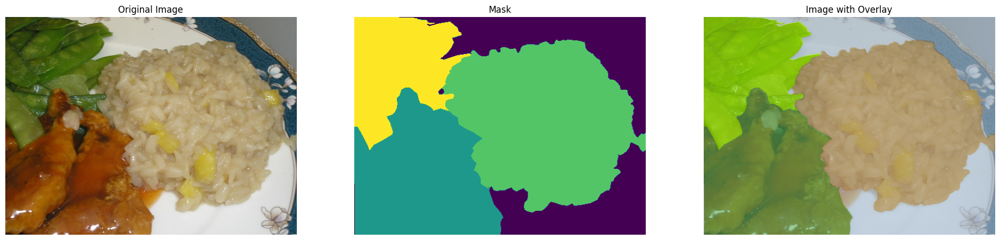

In [73]:
# Extract the first image from the training split of the FoodSeg dataset
# foodseg['train'][0]['image'] accesses the image data of the first sample in the training split
image = foodseg["train"][0]["image"]

# Extract the segmentation mask for the first image
# foodseg['train'][0]['label'] retrieves the segmentation mask, where each pixel value corresponds to a class label
mask = foodseg["train"][0]["label"]

# Extract the classes present in the first image
# foodseg['train'][0]['classes_on_image'] provides a list of class labels that are present in the image
classes_on_image = foodseg["train"][0]["classes_on_image"]

# Display the image with an overlay of the segmentation mask
# display_image_with_overlay is a function that takes an image, its segmentation mask, and the classes present in the image
# It visualizes the image with the segmentation mask overlaid, highlighting different classes
display_image_with_overlay(image, mask, classes_on_image)

In [74]:
# This is a workaround to fix the issue with the bounding boxes created by PyTorch for this dataset


def sanitize_boxes(boxes, epsilon=0.5):
    """
    Sanitizes bounding boxes by ensuring all have positive width and height.

    Parameters:
    boxes (torch.Tensor): A tensor of shape (N, 4) where N is the number of bounding boxes,
                           and each bounding box is represented as [x1, y1, x2, y2].
    epsilon (float): A small value to add to x2 or y2 if needed to ensure positive width/height.

    Returns:
    torch.Tensor: A sanitized tensor of bounding boxes.
    """
    # Ensure the tensor is of the right shape
    assert (
        boxes.ndim == 2 and boxes.size(1) == 4
    ), "Bounding boxes tensor should be of shape (N, 4)"

    x1, y1, x2, y2 = boxes[:, 0], boxes[:, 1], boxes[:, 2], boxes[:, 3]

    # Identify bounding boxes with zero width or height
    zero_width = x2 == x1
    zero_height = y2 == y1

    # Adjust x2 and y2 by a small epsilon where needed
    x2 = torch.where(zero_width, x2 + epsilon, x2)
    y2 = torch.where(zero_height, y2 + epsilon, y2)

    # Reconstruct the tensor
    sanitized_boxes = torch.stack((x1, y1, x2, y2), dim=1)

    return sanitized_boxes

In [75]:
class FoodSegDataset(torch.utils.data.Dataset):
    def __init__(
        self,
        huggingface_dataset: datasets.arrow_dataset.Dataset,
        transforms: torchvision.transforms.v2.Compose,
    ) -> None:
        self.huggingface_dataset = huggingface_dataset
        self.transforms = transforms

    def __getitem__(self, index: int) -> Tuple[torch.Tensor, Dict[str, Any]]:
        # Load the image and mask from the dataset
        image = self.huggingface_dataset[index]["image"].convert("RGB")
        mask = self.huggingface_dataset[index]["label"].convert("L")
        image_id = self.huggingface_dataset[index]["id"]

        # Convert image and mask to tensors
        tfm = torchvision.transforms.v2.Compose(
            [
                torchvision.transforms.v2.ToImage(),
                torchvision.transforms.v2.ToDtype(torch.uint8),
            ]
        )
        image = tfm(image)
        mask = tfm(mask)

        # Get unique object IDs from the mask, excluding background (0)
        classes_on_image = torch.tensor(
            self.huggingface_dataset[index]["classes_on_image"]
        )
        obj_ids = torch.unique(mask)
        obj_ids = obj_ids[1:]  # Remove the background class

        # Create binary masks for each object
        masks = (mask == obj_ids[:, None, None]).to(dtype=torch.uint8)

        # Get bounding boxes from masks
        boxes = torchvision.ops.boxes.masks_to_boxes(masks)
        boxes = sanitize_boxes(boxes)  # Ensure no zero-width or zero-height boxes

        # Get labels for objects present in the image
        labels = classes_on_image[torch.isin(classes_on_image, obj_ids)]

        # Calculate area of bounding boxes
        area = (boxes[:, 3] - boxes[:, 1]) * (boxes[:, 2] - boxes[:, 0])

        # Convert image to torchvision tensor
        image_tensor = torchvision.tv_tensors.Image(image)

        # Assume all instances are not crowd. Crowd instances are the ones where an annotation represents a single object or a group of objects that are too close together or too small to be labeled individually.
        iscrowd = torch.zeros((len(labels),), dtype=torch.uint8)

        # Create the target dictionary with all necessary information
        target: Dict[str, Any] = {
            "boxes": torchvision.tv_tensors.BoundingBoxes(
                boxes,
                format="XYXY",
                canvas_size=torchvision.transforms.v2.functional.get_size(image_tensor),
            ),
            "labels": labels,
            "image_id": image_id,
            "area": area,
            "iscrowd": iscrowd,
            "masks": torchvision.tv_tensors.Mask(masks),
        }

        # Apply transformations if any
        if self.transforms is not None:
            image_tensor, target = self.transforms(image_tensor, target)

        return image_tensor, target

    def __len__(self) -> int:
        return len(self.huggingface_dataset)

In [76]:
class FoodSegDataModule(L.LightningDataModule):
    def __init__(
        self,
        huggingface_train_dataset: datasets.arrow_dataset.Dataset,
        huggingface_valid_dataset: datasets.arrow_dataset.Dataset,
        huggingface_test_dataset: datasets.arrow_dataset.Dataset,
        batch_size: int = 2,
        num_workers: int = 1,
    ) -> None:
        """
        Initialize the FoodSegDataModule.
        This class handles the data preparation and loading for food segmentation tasks.
        """
        super().__init__()
        self.batch_size = batch_size
        self.num_workers = num_workers
        self.huggingface_train_dataset = huggingface_train_dataset
        self.huggingface_valid_dataset = huggingface_valid_dataset
        self.huggingface_test_dataset = huggingface_test_dataset

    def setup(self, stage: Optional[str] = None) -> None:
        """
        Set up the datasets for training, validation, and testing.
        This method is called by PyTorch Lightning to prepare the datasets.
        """
        # Create dataset objects with appropriate transforms
        self.train_dataset = FoodSegDataset(
            self.huggingface_train_dataset, get_transform(is_training=True)
        )
        self.valid_dataset = FoodSegDataset(
            self.huggingface_valid_dataset, get_transform(is_training=False)
        )
        self.test_dataset = FoodSegDataset(
            self.huggingface_test_dataset, get_transform(is_training=False)
        )

    def collate_fn(self, batch):
        """
        Custom collate function to handle batching of data.
        This is necessary for handling variable sized images or masks.
        """
        return tuple(zip(*batch))

    def train_dataloader(self) -> torch.utils.data.DataLoader:
        """
        Create and return the training data loader.
        """
        return torch.utils.data.DataLoader(
            self.train_dataset,
            batch_size=self.batch_size,
            shuffle=True,  # Shuffle training data for better generalization
            num_workers=self.num_workers,
            collate_fn=self.collate_fn,
        )

    def val_dataloader(self) -> torch.utils.data.DataLoader:
        """
        Create and return the validation data loader.
        """
        return torch.utils.data.DataLoader(
            self.valid_dataset,
            batch_size=self.batch_size,
            shuffle=False,  # No need to shuffle validation data
            num_workers=self.num_workers,
            collate_fn=self.collate_fn,
        )

    def test_dataloader(self) -> torch.utils.data.DataLoader:
        """
        Create and return the test data loader.
        """
        return torch.utils.data.DataLoader(
            self.test_dataset,
            batch_size=self.batch_size,
            shuffle=False,  # No need to shuffle test data
            num_workers=self.num_workers,
            collate_fn=self.collate_fn,
        )

In [77]:
id_to_label = {
    0: "Background",
    1: "Candy",
    2: "Egg Tart",
    3: "French Fries",
    4: "Chocolate",
    5: "Biscuit",
    6: "Popcorn",
    7: "Pudding",
    8: "Ice Cream",
    9: "Cheese Butter",
    10: "Cake",
    11: "Wine",
    12: "Milkshake",
    13: "Coffee",
    14: "Juice",
    15: "Milk",
    16: "Tea",
    17: "Almond",
    18: "Red Beans",
    19: "Cashew",
    20: "Dried Cranberries",
    21: "Soy",
    22: "Walnut",
    23: "Peanut",
    24: "Egg",
    25: "Apple",
    26: "Date",
    27: "Apricot",
    28: "Avocado",
    29: "Banana",
    30: "Strawberry",
    31: "Cherry",
    32: "Blueberry",
    33: "Raspberry",
    34: "Mango",
    35: "Olives",
    36: "Peach",
    37: "Lemon",
    38: "Pear",
    39: "Fig",
    40: "Pineapple",
    41: "Grape",
    42: "Kiwi",
    43: "Melon",
    44: "Orange",
    45: "Watermelon",
    46: "Steak",
    47: "Pork",
    48: "Chicken Duck",
    49: "Sausage",
    50: "Fried Meat",
    51: "Lamb",
    52: "Sauce",
    53: "Crab",
    54: "Fish",
    55: "Shellfish",
    56: "Shrimp",
    57: "Soup",
    58: "Bread",
    59: "Corn",
    60: "Hamburg",
    61: "Pizza",
    62: "Hanamaki Baozi",
    63: "Wonton Dumplings",
    64: "Pasta",
    65: "Noodles",
    66: "Rice",
    67: "Pie",
    68: "Tofu",
    69: "Eggplant",
    70: "Potato",
    71: "Garlic",
    72: "Cauliflower",
    73: "Tomato",
    74: "Kelp",
    75: "Seaweed",
    76: "Spring Onion",
    77: "Rape",
    78: "Ginger",
    79: "Okra",
    80: "Lettuce",
    81: "Pumpkin",
    82: "Cucumber",
    83: "White Radish",
    84: "Carrot",
    85: "Asparagus",
    86: "Bamboo Shoots",
    87: "Broccoli",
    88: "Celery Stick",
    89: "Cilantro Mint",
    90: "Snow Peas",
    91: "Cabbage",
    92: "Bean Sprouts",
    93: "Onion",
    94: "Pepper",
    95: "Green Beans",
    96: "French Beans",
    97: "King Oyster Mushroom",
    98: "Shiitake",
    99: "Enoki Mushroom",
    100: "Oyster Mushroom",
    101: "White Button Mushroom",
    102: "Salad",
    103: "Other Ingredients",
}

label_to_id = {v: k for k, v in id_to_label.items()}

In [78]:
# Initialize the FoodSegDataModule with the FoodSeg dataset splits
dm = FoodSegDataModule(
    huggingface_train_dataset=foodseg["train"],
    huggingface_valid_dataset=foodseg["validation"],
    huggingface_test_dataset=foodseg[
        "validation"
    ],  # Use the validation dataset as the test dataset for demonstration purposes
    batch_size=4,
    num_workers=8,
)

# Setup the data module
dm.setup()

In [79]:
# Define hyperparameters for the model
hparams = Namespace(
    lr=5e-3,  # Learning rate
    num_classes=len(id_to_label),  # Number of classes based on the dataset
)

# Initialize WandB logger for experiment tracking
wandb_logger = L.pytorch.loggers.WandbLogger(project="FoodSeg")
wandb_logger.log_hyperparams(hparams)  # Log hyperparameters to WandB

# Create the Mask R-CNN model with specified hyperparameters
model = MaskRCNNModule(**vars(hparams))

# Set up model checkpoint callback
checkpoint_callback = L.pytorch.callbacks.ModelCheckpoint(
    monitor="val_loss",  # Monitor validation loss
    dirpath="checkpoints",  # Directory to save checkpoints
    filename="maskrcnn_foodseg-{epoch:02d}-{val_loss:.2f}",  # Filename format
    save_top_k=1,  # Save only the best model
    mode="min",  # Lower validation loss is better
)

# Set up learning rate monitor callback
lr_monitor_callback = L.pytorch.callbacks.LearningRateMonitor(
    logging_interval="step",  # Log at every step
    log_momentum=True,  # Log momentum if used
    log_weight_decay=True,  # Log weight decay if used
)

# Initialize PyTorch Lightning Trainer
trainer = L.pytorch.Trainer(
    max_epochs=10,  # Train for 10 epochs
    devices=1,  # Use 1 GPU
    precision=16,  # Use mixed precision for faster training
    callbacks=[checkpoint_callback, lr_monitor_callback],  # Add callbacks
    logger=wandb_logger,  # Use WandB logger
    log_every_n_steps=1,  # Log metrics at every step
)

Using 16bit Automatic Mixed Precision (AMP)
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


In [80]:
trainer.fit(model, dm)

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0,1]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name       | Type                  | Params | Mode 
-------------------------------------------------------------
0 | model      | MaskRCNN              | 46.4 M | train
1 | iou_metric | IntersectionOverUnion | 0      | train
-------------------------------------------------------------
46.2 M    Trainable params
225 K     Non-trainable params
46.4 M    Total params
185.718   Total estimated model params size (MB)
240       Modules in train mode
0         Modules in eval mode


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


In [81]:
# WandB site for this run
print(f"URL for this run: {wandb_logger.experiment.url}")

URL for this run: https://wandb.ai/eliasjacob/UrbanSound8K/runs/yesac2uw


In [82]:
print(f"Best model path: {checkpoint_callback.best_model_path}")

Best model path: /media/nas-elias/drive/UFRN/Disciplinas/2024-2/deep_learning_gen_ai/checkpoints/maskrcnn_foodseg-epoch=08-val_loss=0.76.ckpt


In [83]:
# Reload the best model from the checkpoint
model = MaskRCNNModule.load_from_checkpoint(
    checkpoint_callback.best_model_path, **vars(hparams)
)

In [84]:
trainer.test(model, datamodule=dm)

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0,1]


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/iou          │    0.49975496530532837    │
│      test_loss_epoch      │    0.7598006129264832     │
└───────────────────────────┴───────────────────────────┘

[{'test_loss_epoch': 0.7598006129264832, 'test/iou': 0.49975496530532837}]

torch.Size([3, 667, 1000])
torch.Size([3, 667, 1000])


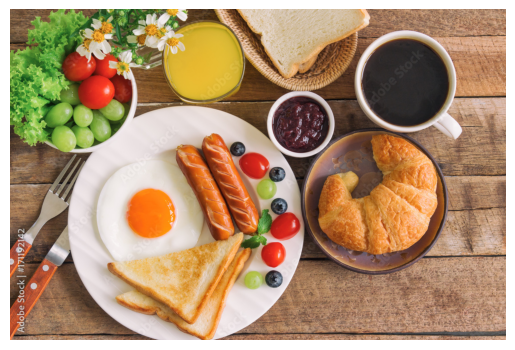

In [85]:
# Read the image from the specified file path
image = torchvision.io.image.read_image("images/breakfast.png")

# Print the shape of the image tensor (should be [channels, height, width])
print(image.shape)

# Convert the image from RGBA (4 channels) to RGB (3 channels) by keeping only the first 3 channels
image = image[:3]

# Print the shape of the image tensor after conversion (should be [3, height, width])
print(image.shape)

# Remove x-axis and y-axis ticks from the plot
plt.axis("off")

# Permute the dimensions from [channels, height, width] to [height, width, channels] for correct display
plt.imshow(image.permute(1, 2, 0))

# Display the image using matplotlib
plt.show()

In [86]:
# Apply the evaluation transformation to the input image
eval_transform = get_transform(is_training=False)

# Set the model to evaluation mode
model.eval()

# Disable gradient calculation for inference
with torch.no_grad():
    # Ensure the image is in RGB format by keeping only the first three channels
    image = image[:3, ...]

    # Apply the evaluation transformation to the image
    x = eval_transform(image)

    # Convert RGBA to RGB and move the image to the same device as the model
    x = x.to(model.device)

    # Get predictions from the model
    predictions = model(
        [
            x,
        ]
    )
    pred = predictions[0]

    # Keep only predictions with a score >= 0.5
    keep = pred["scores"] >= 0.5
    pred = {k: v[keep] for k, v in pred.items()}

# Normalize the image to the range [0, 255] and convert to uint8
image = (255.0 * (image - image.min()) / (image.max() - image.min())).to(torch.uint8)

# Generate labels for the predictions with their scores
pred_labels = [
    f"{id_to_label[int(i)]}: {s:.2f}" for i, s in zip(pred["labels"], pred["scores"])
]

# Display the prediction labels
pred_labels

['Sauce: 0.98',
 'Sauce: 0.97',
 'Egg: 0.92',
 'Sausage: 0.85',
 'Sauce: 0.76',
 'Biscuit: 0.64',
 'Tomato: 0.61',
 'Tomato: 0.60']

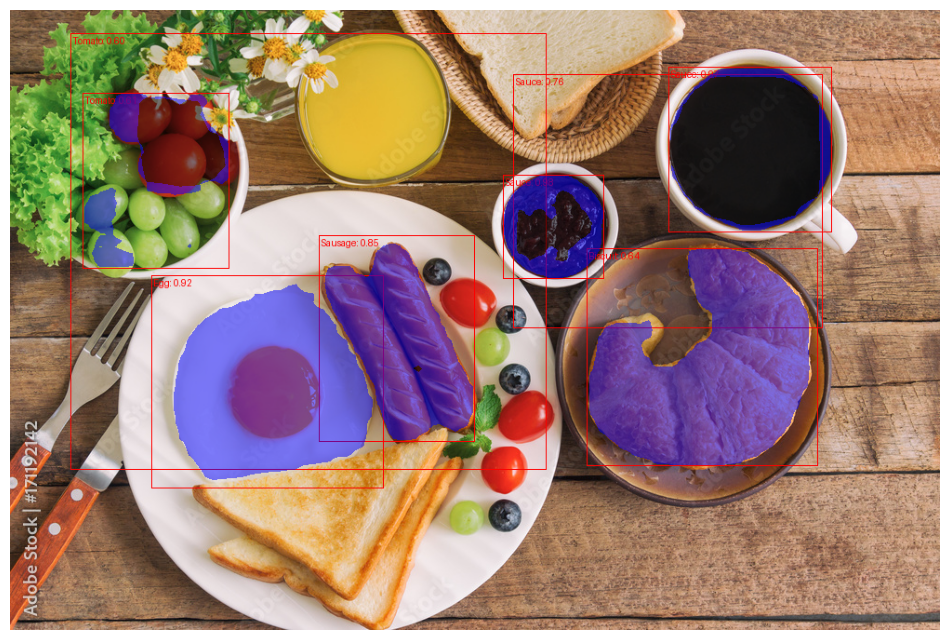

In [87]:
# Convert the predicted bounding boxes to long type and move them to the CPU
pred_boxes = pred["boxes"].long().cpu()

# Apply a threshold to the predicted masks to create binary masks
# Squeeze removes the channel dimension (1) from the masks tensor
masks = (pred["masks"] > 0.7).squeeze(1)

# Draw the bounding boxes on the image with the specified labels and color
output_image = torchvision.utils.draw_bounding_boxes(
    image, pred_boxes, pred_labels, colors="red"
)

# Draw the segmentation masks on the image with the specified transparency (alpha) and color
output_image = torchvision.utils.draw_segmentation_masks(
    output_image, masks, alpha=0.5, colors="blue"
)

# Create a new figure with a specified size
plt.figure(figsize=(12, 12))

# Remove x-axis and y-axis ticks from the plot for a cleaner look
plt.axis("off")

# Display the image with bounding boxes and masks using matplotlib
# Permute the dimensions from [channels, height, width] to [height, width, channels] for correct display
plt.imshow(output_image.permute(1, 2, 0))
plt.show()

torch.Size([3, 487, 1014])
torch.Size([3, 487, 1014])


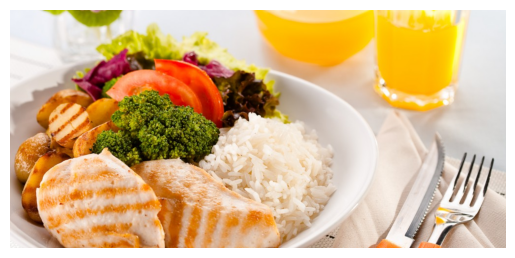

In [88]:
# Read the image from the specified file path
image = torchvision.io.image.read_image("images/lunch.jpg")

# Print the shape of the image tensor (should be [channels, height, width])
print(image.shape)

# Convert the image from RGBA (4 channels) to RGB (3 channels) by keeping only the first 3 channels
image = image[:3]

# Print the shape of the image tensor after conversion (should be [3, height, width])
print(image.shape)

# Remove x-axis and y-axis ticks from the plot
plt.axis("off")

# Permute the dimensions from [channels, height, width] to [height, width, channels] for correct display
plt.imshow(image.permute(1, 2, 0))

# Display the image using matplotlib
plt.show()

In [89]:
# Apply the evaluation transformation to the input image
eval_transform = get_transform(is_training=False)

# Set the model to evaluation mode
model.eval()

# Disable gradient calculation for inference
with torch.no_grad():
    # Ensure the image is in RGB format by keeping only the first three channels
    image = image[:3, ...]

    # Apply the evaluation transformation to the image
    x = eval_transform(image)

    # Convert RGBA to RGB and move the image to the same device as the model
    x = x.to(model.device)

    # Get predictions from the model
    predictions = model(
        [
            x,
        ]
    )
    pred = predictions[0]

    # Keep only predictions with a score >= 0.5
    keep = pred["scores"] >= 0.5
    pred = {k: v[keep] for k, v in pred.items()}

# Normalize the image to the range [0, 255] and convert to uint8
image = (255.0 * (image - image.min()) / (image.max() - image.min())).to(torch.uint8)

# Generate labels for the predictions with their scores
pred_labels = [
    f"{id_to_label[int(i)]}: {s:.2f}" for i, s in zip(pred["labels"], pred["scores"])
]

# Display the prediction labels
pred_labels

['Rice: 0.99',
 'Broccoli: 0.97',
 'Tomato: 0.96',
 'Juice: 0.92',
 'Lettuce: 0.71',
 'Chicken Duck: 0.58']

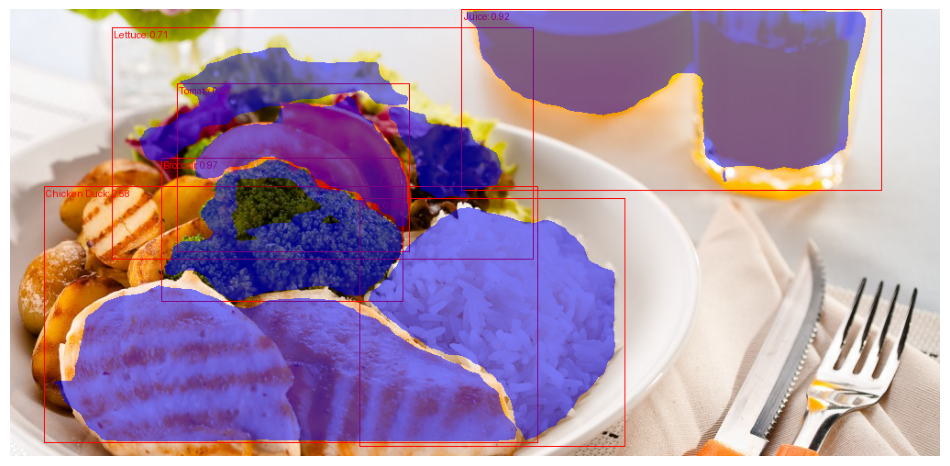

In [90]:
# Convert the predicted bounding boxes to long type and move them to the CPU
pred_boxes = pred["boxes"].long().cpu()

# Apply a threshold to the predicted masks to create binary masks
# Squeeze removes the channel dimension (1) from the masks tensor
masks = (pred["masks"] > 0.7).squeeze(1)

# Draw the bounding boxes on the image with the specified labels and color
output_image = torchvision.utils.draw_bounding_boxes(
    image, pred_boxes, pred_labels, colors="red"
)

# Draw the segmentation masks on the image with the specified transparency (alpha) and color
output_image = torchvision.utils.draw_segmentation_masks(
    output_image, masks, alpha=0.5, colors="blue"
)

# Create a new figure with a specified size
plt.figure(figsize=(12, 12))

# Remove x-axis and y-axis ticks from the plot for a cleaner look
plt.axis("off")

# Display the image with bounding boxes and masks using matplotlib
# Permute the dimensions from [channels, height, width] to [height, width, channels] for correct display
plt.imshow(output_image.permute(1, 2, 0))
plt.show()

torch.Size([3, 980, 1715])
torch.Size([3, 980, 1715])


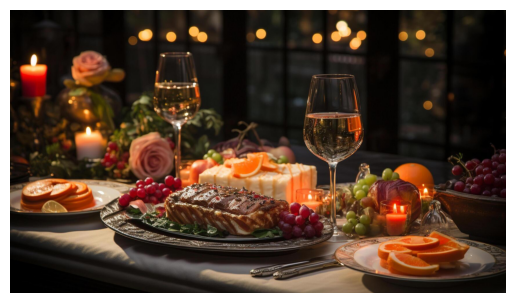

In [91]:
# Read the image from the specified file path
image = torchvision.io.image.read_image("images/dinner.jpg")

# Print the shape of the image tensor (should be [channels, height, width])
print(image.shape)

# Convert the image from RGBA (4 channels) to RGB (3 channels) by keeping only the first 3 channels
image = image[:3]

# Print the shape of the image tensor after conversion (should be [3, height, width])
print(image.shape)

# Remove x-axis and y-axis ticks from the plot
plt.axis("off")

# Permute the dimensions from [channels, height, width] to [height, width, channels] for correct display
plt.imshow(image.permute(1, 2, 0))

# Display the image using matplotlib
plt.show()

In [92]:
# Apply the evaluation transformation to the input image
eval_transform = get_transform(is_training=False)

# Set the model to evaluation mode
model.eval()

# Disable gradient calculation for inference
with torch.no_grad():
    # Ensure the image is in RGB format by keeping only the first three channels
    image = image[:3, ...]

    # Apply the evaluation transformation to the image
    x = eval_transform(image)

    # Convert RGBA to RGB and move the image to the same device as the model
    x = x.to(model.device)

    # Get predictions from the model
    predictions = model(
        [
            x,
        ]
    )
    pred = predictions[0]

    # Keep only predictions with a score >= 0.5
    keep = pred["scores"] >= 0.5
    pred = {k: v[keep] for k, v in pred.items()}

# Normalize the image to the range [0, 255] and convert to uint8
image = (255.0 * (image - image.min()) / (image.max() - image.min())).to(torch.uint8)

# Generate labels for the predictions with their scores
pred_labels = [
    f"{id_to_label[int(i)]}: {s:.2f}" for i, s in zip(pred["labels"], pred["scores"])
]

# Display the prediction labels
pred_labels

['Wine: 0.93',
 'Grape: 0.87',
 'Steak: 0.69',
 'Tomato: 0.61',
 'Wine: 0.60',
 'Tomato: 0.53']

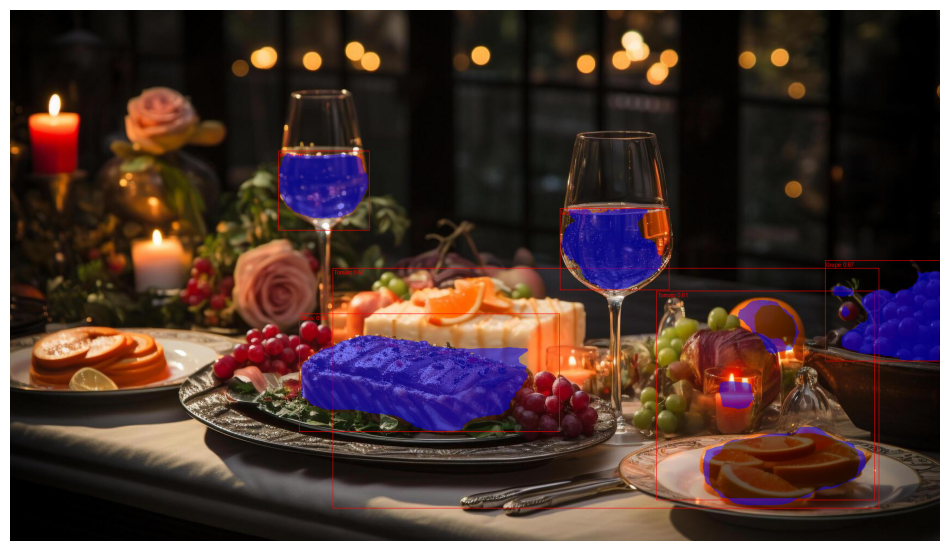

In [93]:
# Convert the predicted bounding boxes to long type and move them to the CPU
pred_boxes = pred["boxes"].long().cpu()

# Apply a threshold to the predicted masks to create binary masks
# Squeeze removes the channel dimension (1) from the masks tensor
masks = (pred["masks"] > 0.7).squeeze(1)

# Draw the bounding boxes on the image with the specified labels and color
output_image = torchvision.utils.draw_bounding_boxes(
    image, pred_boxes, pred_labels, colors="red"
)

# Draw the segmentation masks on the image with the specified transparency (alpha) and color
output_image = torchvision.utils.draw_segmentation_masks(
    output_image, masks, alpha=0.5, colors="blue"
)

# Create a new figure with a specified size
plt.figure(figsize=(12, 12))

# Remove x-axis and y-axis ticks from the plot for a cleaner look
plt.axis("off")

# Display the image with bounding boxes and masks using matplotlib
# Permute the dimensions from [channels, height, width] to [height, width, channels] for correct display
plt.imshow(output_image.permute(1, 2, 0))
plt.show()

## Wrapping Up

In this section, we explored the concept of image segmentation, a crucial task in computer vision that involves partitioning an image into multiple segments to simplify its representation and aid detailed analysis. Image segmentation provides pixel-level information about the various elements within an image, allowing for more precise understanding compared to object detection.

### Key Points Covered

1. **Definition and Importance**: Image segmentation not only identifies the objects in an image but also delineates their exact shapes by labeling each pixel as belonging to a specific category.

2. **Pixel-Level Classification**: This process assigns a class label to each pixel in the image, enabling a more detailed and accurate representation compared to bounding boxes used in object detection.

-----

# Feature Extraction

## Introduction

Feature extraction is a fundamental technique in machine learning and computer vision used to transform raw data into a set of meaningful features. These features encapsulate essential information from the data, enabling models to learn patterns and make accurate predictions.

### Deep Learning and Pre-trained Models

In the realm of deep learning, feature extraction is often carried out using **pre-trained models**. These are neural networks trained on extensive datasets to recognize various patterns and features. Leveraging pre-trained models allows us to extract high-level features from images, text, and other data types. These extracted features can then be employed as inputs for downstream tasks such as classification, regression, and clustering. Essentially, using pre-trained models as feature extractors simplifies the process, as we train classifiers on top of these extracted features.

### Embeddings

The high-level features obtained during feature extraction are represented as dense vectors known as **embeddings**. These embeddings capture basic patterns and characteristics of the data, making them highly effective for a variety of machine learning tasks.

### Application: Similarity Search

A particularly intriguing application of feature extraction is **similarity search**. In similarity search, embeddings of data points are compared to find similar items. This technique is widely employed in recommendation systems, search engines, and content-based filtering, where the objective is to find items akin to a given query.

For instance, in an *information retrieval system* like reverse image search, the goal is to determine which images from a set of candidate images are most similar to a given query image.

## Computing Embeddings

To compute embeddings from images, we use a vision model that understands how to represent input images in vector space. This type of model is commonly referred to as an **image encoder**, as it encodes the input image into a dense vector representation. This representation is then used to compare the similarity between different images.

<p align="center">
<img src="images/vision_embeddings.png" alt="Vision Embeddings" style="width: 50%; height: 50%"/>
</p>

<p align="center">
<img src="images/vision_encoders.png" alt="Vision Encoders" style="width: 50%; height: 50%"/>
</p>

### The Encoder

The encoder is a neural network designed to take an image as input and output a dense vector representation called an **embedding**. This embedding captures the essential features of the image in a lower-dimensional space. Typically, encoders are pre-trained on large datasets to learn meaningful representations of images. Popular pre-trained encoders include ResNet, VGG, Beginning, and Vision Transformers.


## Defining Similarity

To build an effective system, we need to define how to compute the similarity between two images. A common practice is to compute dense representations (embeddings) of the images and then use a vector similarity metric to quantify their similarity.

Using embeddings allows us to compress the high-dimensional pixel space of images (e.g., 224 x 224 x 3) into a much lower dimensional space (e.g., 768). The primary benefit is the reduced computation time in subsequent steps.

## Similarity Metrics

Several similarity metrics can be used to compare embeddings of different images. Some of the most widely used metrics include:

1. **Cosine Similarity**: Measures the cosine of the angle between two vectors. It ranges from -1 (opposite directions) to 1 (same direction), with 0 indicating orthogonality. Cosine similarity is invariant to the magnitude of the vectors, making it ideal for comparing embeddings.
2. **Inner Product**: Measures the sum of the products of corresponding elements of two vectors. It is equivalent to the cosine similarity when the vectors are normalized.
3. **Euclidean Distance**: Measures the straight-line distance between two points in Euclidean space. Smaller distances indicate greater similarity. This is also known as L2 distance. Note that for this metric to be effective, vectors need to be normalized.

<p align="center">
<img src="images/similarity_search.avif" alt="Similarity Search" style="width: 50%; height: 50%"/>
</p>

`Let's see a basic implementation of feature extraction using a pre-trained image encoder and similarity search.`

## The dataset

For simplicity, we will use the already known Cats vs Dogs dataset. This dataset contains images of cats and dogs, which we will use to demonstrate feature extraction and similarity search. We'll then compare the embeddings of different images to find similar images within the dataset. We'll work with a random sample of 10000 images from the dataset for this demonstration.

In [94]:
# Load the Cats vs Dogs dataset using the Hugging Face datasets library
# "microsoft/cats_vs_dogs" is the identifier for the dataset on the Hugging Face Hub
# trust_remote_code=True allows the execution of any code provided by the dataset's loading script
# This is necessary for datasets that require custom loading logic
cats_dogs = datasets.load_dataset("microsoft/cats_vs_dogs", trust_remote_code=True)

In [95]:
# Create a list of images and labels
sample_cats_dogs = cats_dogs["train"].shuffle(seed=271828).select(range(10000))
sample_cats_dogs

Dataset({
    features: ['image', 'labels'],
    num_rows: 10000
})

In [96]:
# Create a Pandas Series from the labels of the first 500 samples in the Cats vs Dogs dataset
# sample_cats_dogs[i]['labels'] accesses the label of the i-th sample in the dataset
# The list comprehension [sample_cats_dogs[i]['labels'] for i in range(500)] collects the labels of the first 500 samples
# pd.Series(...) converts the list of labels into a Pandas Series
labels_series = pd.Series([sample_cats_dogs[i]["labels"] for i in range(500)])

# Count the occurrences of each label in the Series
# value_counts() returns a Series containing counts of unique values in the labels_series
# This helps in understanding the distribution of labels (e.g., how many samples are cats and how many are dogs)
label_counts = labels_series.value_counts()

# Display the counts of each label
label_counts

0    252
1    248
Name: count, dtype: int64

In [97]:
sample_cats_dogs

Dataset({
    features: ['image', 'labels'],
    num_rows: 10000
})

In [98]:
sample_cats_dogs[0]

{'image': <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=500x420>,
 'labels': 1}

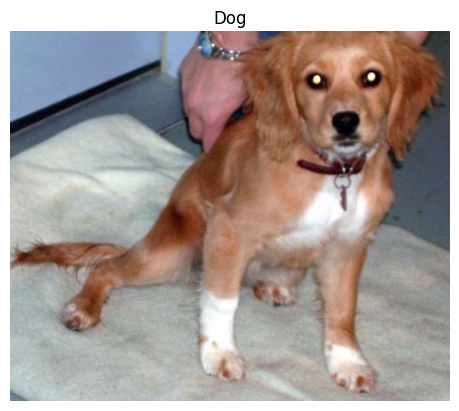

In [99]:
# Set the index of the sample to display
idx = 0

# Display the image of the selected sample using matplotlib
# sample_cats_dogs[idx]['image'] retrieves the image data of the sample at index idx
plt.imshow(sample_cats_dogs[idx]["image"])

# Remove the axis for a cleaner display of the image
plt.axis("off")

# Set the title of the plot based on the label of the sample
# sample_cats_dogs[idx]['labels'] == 0 checks if the label is 0 (indicating a cat)
# If the label is 0, the title is set to 'Cat'; otherwise, it is set to 'Dog'
plt.title("Cat" if sample_cats_dogs[idx]["labels"] == 0 else "Dog")

# Show the plot with the image and title
plt.show()

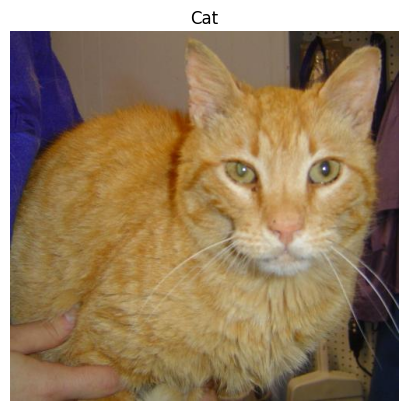

In [100]:
# Set the index of the sample to display
idx = 4

# Display the image of the selected sample using matplotlib
# sample_cats_dogs[idx]['image'] retrieves the image data of the sample at index idx
plt.imshow(sample_cats_dogs[idx]["image"])

# Remove the axis for a cleaner display of the image
plt.axis("off")

# Set the title of the plot based on the label of the sample
# sample_cats_dogs[idx]['labels'] == 0 checks if the label is 0 (indicating a cat)
# If the label is 0, the title is set to 'Cat'; otherwise, it is set to 'Dog'
plt.title("Cat" if sample_cats_dogs[idx]["labels"] == 0 else "Dog")

# Show the plot with the image and title
plt.show()

### Loading a Base Model to Compute Embeddings

**Embeddings** encode the semantic information of images by transforming them into dense vector representations. To compute these embeddings, we use a vision model capable of representing input images in vector space. Such models are commonly referred to as **image encoders**.

To load the model, we use the [`AutoModel` class](https://huggingface.co/docs/transformers/model_doc/auto#transformers.AutoModel) from Hugging Face. This class provides a unified interface for loading any compatible model checkpoints available on the Hugging Face Hub.

Additionally, alongside the model, we also load the corresponding processor for data preprocessing. The processor ensures that the input images are pre-processed correctly before being passed through the model to obtain embeddings. This step is crucial as it standardizes the input, making sure that the embeddings are consistent and meaningful.

Using `AutoModel` and the associated processor streamlines the process of loading and preparing pre-trained models, enabling efficient computation of image embeddings for various machine learning tasks.

We'll use the `ViT` model, a Vision Transformer, to compute embeddings for the images in the Cats vs Dogs dataset. The embeddings will capture the essential features of each image, allowing us to compare their similarity effectively. [This version was fine-tuned](https://huggingface.co/akahana/vit-base-cats-vs-dogs) on the cats vs dogs dataset.

In [101]:
from transformers import AutoFeatureExtractor, AutoModel

# Specify the model checkpoint for the pre-trained model
model_ckpt = "akahana/vit-base-cats-vs-dogs"

# Load the feature extractor from the pre-trained model checkpoint
extractor = AutoFeatureExtractor.from_pretrained(model_ckpt)

# Load the model from the pre-trained model checkpoint
model = AutoModel.from_pretrained(model_ckpt)

# Get the hidden size (dimension) of the model's embeddings
hidden_dim = model.config.hidden_size

preprocessor_config.json:   0%|          | 0.00/228 [00:00<?, ?B/s]

2024-12-09 19:51:25.352951: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1733784685.369730 3139123 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1733784685.374788 3139123 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-12-09 19:51:25.392012: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
/home/jacob/.cache/pypoetry/virtualenvs/deep-learning-gen-ai-vEhrekpc-py3.12/lib/python3.12/site-packages/transformers/models

config.json:   0%|          | 0.00/691 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/343M [00:00<?, ?B/s]

Some weights of ViTModel were not initialized from the model checkpoint at akahana/vit-base-cats-vs-dogs and are newly initialized: ['vit.pooler.dense.bias', 'vit.pooler.dense.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


> ### Understanding Model Selection and Warnings
>
> When working with models, you may encounter warnings indicating that the fundamental model did not utilize certain components, such as the `classifier`. This raises a couple of important questions:
>
> #### Why Did We Not Use `AutoModelForImageClassification`?
>
> The key reason for not utilizing `AutoModelForImageClassification` lies in our objective. Our goal is to obtain **dense representations** (embeddings) of the images rather than discrete categories (labels). `AutoModelForImageClassification` is designed specifically for tasks where the goal is to classify images into predefined categories, providing outputs like "cat," "dog," etc. In contrast, we need embeddings, which capture semantic information about the images in a continuous vector space, enabling downstream tasks such as similarity searches or clustering.
>
> #### Why Choose This Particular Checkpoint?
>
> Another related question involves the choice of the specific checkpoint we are using. Here’s why we decided on this particular one:
>
> - **Dataset Specificity**: We are building our system based on a specific dataset. Leveraging a model fine-tuned on this dataset enhances the performance since the model has already learned the characteristics and nuances of the dataset. This means the embeddings will be more accurate and relevant.
>
> - **Generalist Models vs. Specialized Models**: While generalist models, such as those trained on broad datasets like [ImageNet-1k](https://huggingface.co/models?dataset=dataset:imagenet-1k&sort=downloads), offer versatility, they might lack the specialized understanding required for our particular dataset. A model fine-tuned on our dataset ensures better alignment with our specific data distribution and task requirements.
>

## Loading Our Candidate Images

### Dog Photos
We'll be using photos of two lovely Schnauzers that live with me:
- **`Snowden`**: Snowden came from Porto Alegre and is cherished as a special family member.
- **`Thor`**: Thor came from Mossoró and, like Snowden, holds a special place in our family.

These personal photos ensure that we have quality from out-of-distribution data to test the similarity search system.

### Cat Photos
Since I don't currently have any cats at home, we'll use random photos of cats found on the Internet.
While these photos aren't as personal as those of Snowden and Thor, they will still serve our purpose well by providing the necessary variety for our dataset.

In [102]:
labels = sample_cats_dogs.features["labels"].names
label_to_id, id_to_label = dict(), dict()

for i, label in enumerate(labels):
    label_to_id[label] = i
    id_to_label[i] = label

label_to_id, id_to_label

({'cat': 0, 'dog': 1}, {0: 'cat', 1: 'dog'})

## Overview of Fetching Similar Images

Below, you can find a visual representation of the process for fetching similar images:

<p align="center">
<img src="images/fetch-similar-process.png" alt="Vision Encoders" style="width: 50%; height: 50%"/>
</p>


### Breaking Down the Process

1. **Extract Embeddings from Candidate Images**:
    - We start by extracting embeddings (feature vectors) from our set of candidate images, referred to as `candidate_subset`.
    - These embeddings are stored in a matrix for easy access and comparison.

2. **Extract Embedding from Query Image**:
    - Next, we take a query image (the image for which we want to find similar images) and extract its embedding.

3. **Compute Similarity Scores**:
    - We then reiterate over the embedding matrix (computed in step 1).
    - For each candidate embedding, we compute the similarity score between it and the query embedding.
    - Usually, we maintain a mapping structure (similar to a dictionary) that keeps track of the correspondence between some identifier of the candidate image and the computed similarity scores.

4. **Sort and Retrieve Identifiers**:
    - After computing the similarity scores, we sort the mapping structure based on these scores.
    - Finally, we return the identifiers associated with the highest similarity scores, enabling us to fetch the most similar candidate images.

In the following steps, we'll implement this procedure in code.


> As you can imagine, the fact that we'll need to make pairwise comparisons between the query image and all candidate images can be computationally expensive. This is especially true when dealing with large datasets or high-dimensional embeddings. To optimize this process, you can consider using approximate nearest neighbors (ANN) algorithms like. Some vector databases, such as [ChromaDB](https://www.trychroma.com/), are specifically designed for this purpose, offering efficient similarity search capabilities for large-scale applications. We'll learn more about vector databases in future sections.

In [103]:
# Data transformation chain.
transformation_chain = torchvision.transforms.v2.Compose(
    [
        # Convert the image to a torchvision Image
        torchvision.transforms.v2.ToImage(),
        # Resize the input image to 256x256 while maintaining the aspect ratio.
        torchvision.transforms.v2.Resize(int((256 / 224) * extractor.size["height"])),
        # Crop the center of the image to the size expected by the extractor.
        torchvision.transforms.v2.CenterCrop(extractor.size["height"]),
        # Convert the image to float32 and scale pixel values to [0, 1]
        torchvision.transforms.v2.ToDtype(torch.float32, scale=True),
        # Normalize the image using the mean and standard deviation values from the extractor.
        torchvision.transforms.v2.ToPureTensor(),
        # Keep only the first three channels (RGB) and discard the alpha channel (A)
        torchvision.transforms.v2.Lambda(lambda x: x[:3]),
        # Normalize the image using the mean and standard deviation values from the extractor.
        torchvision.transforms.v2.Normalize(
            mean=extractor.image_mean, std=extractor.image_std
        ),
    ]
)

In [104]:
def extract_embeddings(
    model: torch.nn.Module,
) -> Callable[[Dict[str, Any]], Dict[str, torch.Tensor]]:
    """
    Utility to compute embeddings from a given model.

    Args:
        model (torch.nn.Module): The model used to compute embeddings.

    Returns:
        Callable[[Dict[str, Any]], Dict[str, torch.Tensor]]: A function that processes a batch and returns embeddings.
    """
    device = model.device

    def process_batch(batch: Dict[str, Any]) -> Dict[str, torch.Tensor]:
        """
        Process a batch of images to compute embeddings.

        Args:
            batch (Dict[str, Any]): A dictionary containing a batch of images.

        Returns:
            Dict[str, torch.Tensor]: A dictionary containing the computed embeddings.
        """
        images = batch["image"]

        # Transform each image in the batch using the transformation chain
        transformed_image_batch = torch.stack(
            [transformation_chain(image) for image in images]
        )

        # Move the transformed images to the appropriate device
        new_batch = {"pixel_values": transformed_image_batch.to(device)}

        # Compute embeddings without gradient calculation
        with torch.no_grad():
            embeddings = model(**new_batch).last_hidden_state[:, 0].cpu()

        return {"embeddings": embeddings}

    return process_batch

In [105]:
# Here, we map the embedding extraction utility on our subset of candidate images.
batch_size = 512

# Define the device to use
device = "cuda" if torch.cuda.is_available() else "cpu"

# Move the model to the appropriate device
embedding_extraction_function = extract_embeddings(model.to(device))

# Apply the embedding extraction function to the candidate subset
cats_dogs_embeddings = sample_cats_dogs.map(
    embedding_extraction_function, batched=True, batch_size=batch_size
)

Map:   0%|          | 0/10000 [00:00<?, ? examples/s]

In [106]:
embeddings_ids = []

for id in tqdm(range(len(cats_dogs_embeddings))):
    label = cats_dogs_embeddings[id]["labels"]

    # Create a unique indentifier.
    entry = str(id) + "_" + str(label)

    embeddings_ids.append(entry)

100%|██████████| 10000/10000 [00:13<00:00, 724.19it/s]


In [107]:
all_embeddings = np.array(cats_dogs_embeddings["embeddings"])
all_embeddings = torch.from_numpy(all_embeddings)

In [108]:
def compute_cosine_similarity(
    embedding_one: torch.Tensor, embedding_two: torch.Tensor
) -> List[float]:
    """
    Computes cosine similarity between two vectors.

    Args:
        embedding_one (torch.Tensor): The first embedding vector.
        embedding_two (torch.Tensor): The second embedding vector.

    Returns:
        List[float]: A list of cosine similarity scores.
    """
    # Calculate cosine similarity between the two embeddings
    # This measures the cosine of the angle between the vectors in a multi-dimensional space
    cosine_similarity_scores = torch.nn.functional.cosine_similarity(
        embedding_one, embedding_two
    )

    # Convert the similarity scores to a list of floats and return
    # This step is necessary as the output might be needed in a format other than PyTorch tensor
    return cosine_similarity_scores.numpy().tolist()


def fetch_top_k_similar_images(
    query_image: torch.Tensor,
    candidate_embeddings: torch.Tensor,
    embedding_ids: List[str],
    top_k: int = 5,
) -> Tuple[List[int], List[int]]:
    """
    Fetches the `top_k` similar images with `query_image` as the query.

    Args:
        query_image (torch.Tensor): The input query image.
        candidate_embeddings (torch.Tensor): The embeddings of candidate images.
        embedding_ids (List[str]): The identifiers of the candidate embeddings.
        top_k (int, optional): The number of top similar images to fetch. Defaults to 5.

    Returns:
        Tuple[List[int], List[int]]: A tuple containing two lists:
            - The first list contains the IDs of the top similar images.
            - The second list contains the labels of the top similar images.
    """
    # Prepare the input query image for embedding computation
    # This involves applying necessary transformations and adding a batch dimension
    transformed_query_image = transformation_chain(query_image).unsqueeze(0)
    new_batch = {"pixel_values": transformed_query_image.to(device)}

    # Compute the embedding for the query image
    # We use torch.no_grad() to prevent unnecessary computation of gradients
    with torch.no_grad():
        query_embedding = model(**new_batch).last_hidden_state[:, 0].cpu()

    # Compute similarity scores between the query embedding and all candidate embeddings
    similarity_scores = compute_cosine_similarity(candidate_embeddings, query_embedding)

    # Create a mapping between candidate image identifiers and their similarity scores
    similarity_mapping = dict(zip(embedding_ids, similarity_scores))

    # Sort the mapping dictionary by similarity scores in descending order
    # Then select the top_k candidates
    sorted_similarity_mapping = dict(
        sorted(similarity_mapping.items(), key=lambda x: x[1], reverse=True)
    )
    top_k_ids = list(sorted_similarity_mapping.keys())[:top_k]

    # Extract IDs and labels from the sorted similarity mapping
    # Assuming the format of each ID is "image_id_label"
    image_ids = list(map(lambda x: int(x.split("_")[0]), top_k_ids))
    image_labels = list(map(lambda x: int(x.split("_")[-1]), top_k_ids))

    return image_ids, image_labels

In [109]:
dogs = glob("images/snowden*.jpg") + glob("images/thor*.jpg")
cats = glob("images/cat*.jpg")

dogs, cats

(['images/snowden3.jpg',
  'images/snowden1.jpg',
  'images/snowden2.jpg',
  'images/thor5.jpg',
  'images/thor4.jpg',
  'images/thor3.jpg',
  'images/thor2.jpg',
  'images/thor1.jpg'],
 ['images/cat1.jpg', 'images/cat2.jpg', 'images/cat3.jpg'])

In [110]:
def display_similar_images(query_image_path: str) -> None:
    """
    Display the query image and the top 5 similar images.

    Args:
        query_image_path (str): The file path of the query image.

    Returns:
        None
    """
    # Read and display the query image
    plt.figure(figsize=(6, 6))
    query_image = torchvision.io.read_image(query_image_path)
    plt.imshow(query_image.permute(1, 2, 0))
    plt.axis("off")
    plt.title("Query Image")
    plt.show()

    # Fetch the top 5 similar images and their labels
    similar_image_ids, similar_image_labels = fetch_top_k_similar_images(
        query_image, all_embeddings, embeddings_ids, top_k=5
    )

    # Create a new figure with a larger size for displaying similar images
    plt.figure(figsize=(20, 20))  # Increased figure size for larger images

    # Display each of the top 5 similar images
    for i, image_id in enumerate(similar_image_ids):
        similar_image = sample_cats_dogs[image_id]["image"]
        plt.subplot(1, 5, i + 1)
        plt.imshow(similar_image)
        plt.axis("off")
        plt.title(id_to_label[similar_image_labels[i]])

    plt.show()

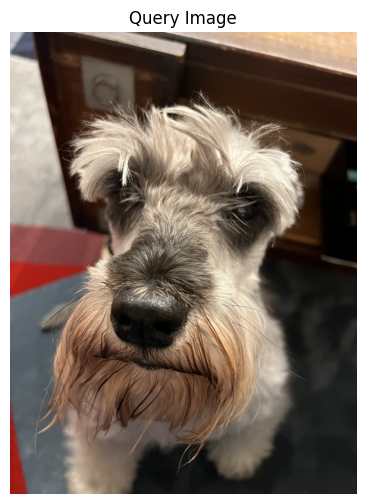

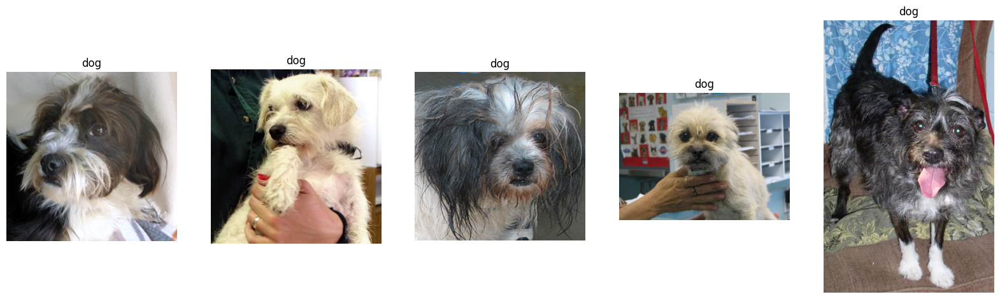

In [111]:
display_similar_images(dogs[0])

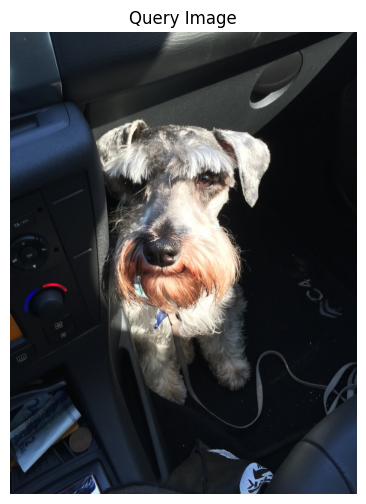

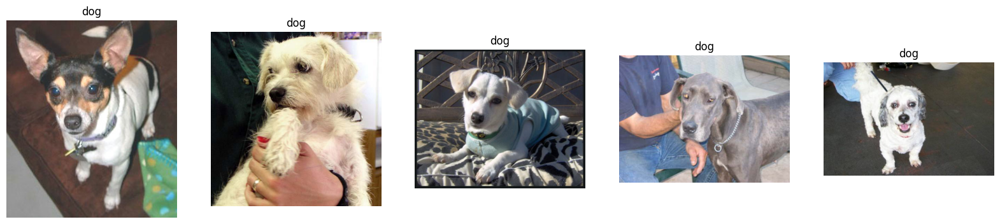

In [112]:
display_similar_images(dogs[1])

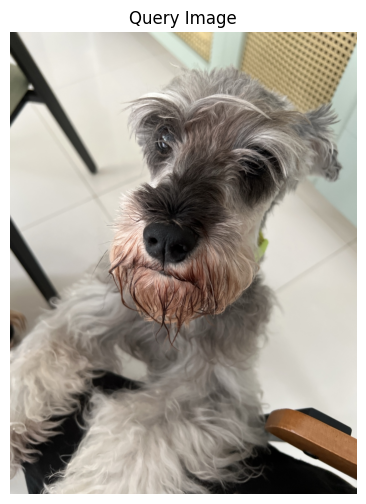

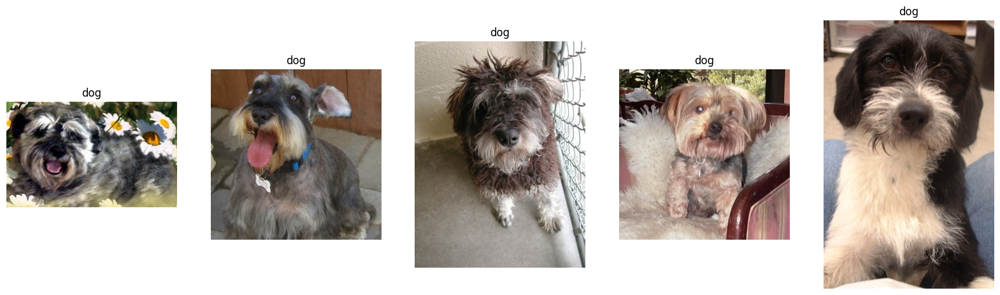

In [113]:
display_similar_images(dogs[2])

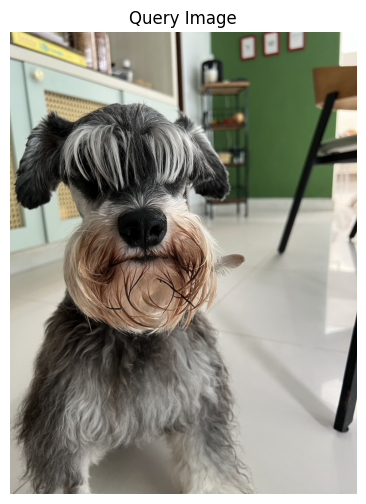

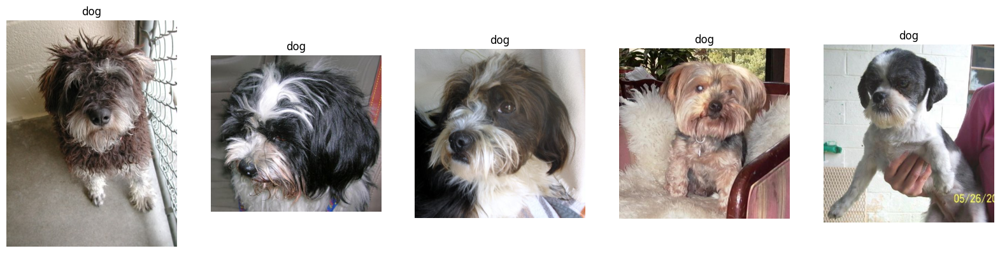

In [114]:
display_similar_images(dogs[3])

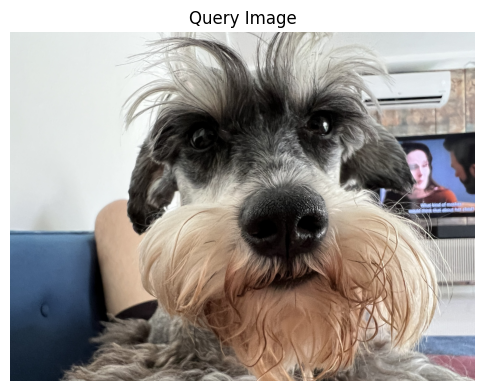

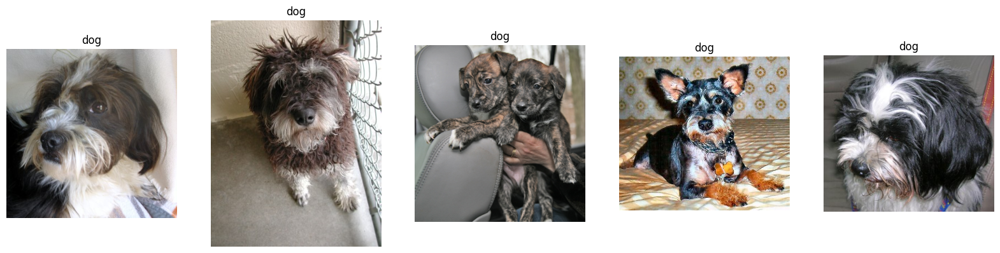

In [115]:
display_similar_images(dogs[4])

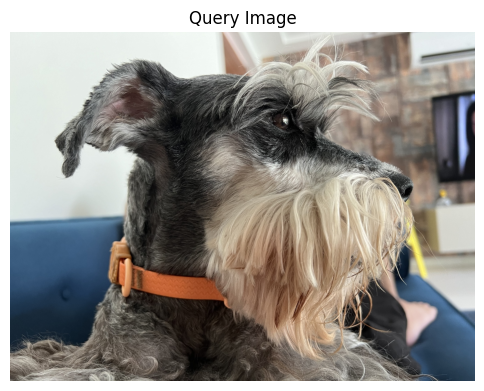

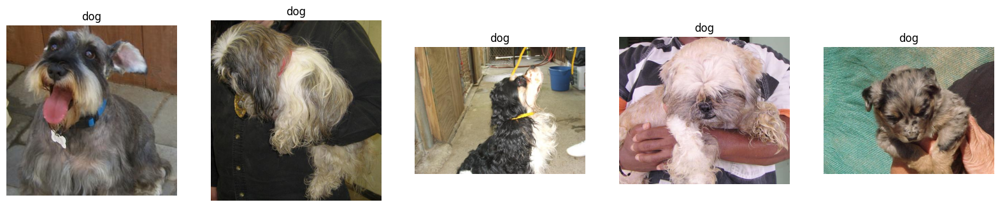

In [116]:
display_similar_images(dogs[5])

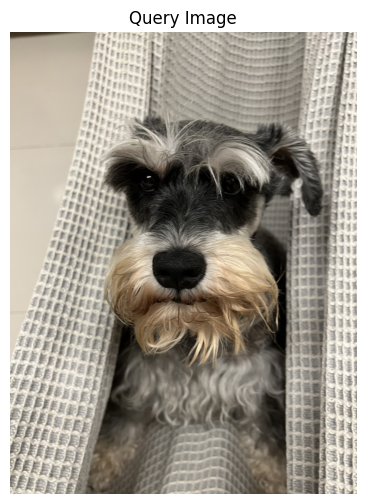

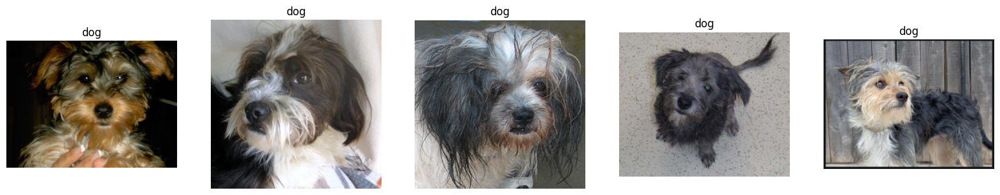

In [117]:
display_similar_images(dogs[6])

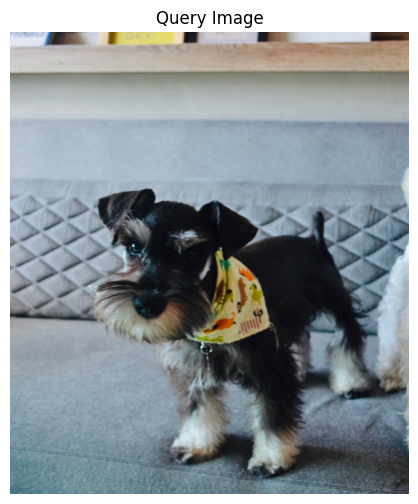

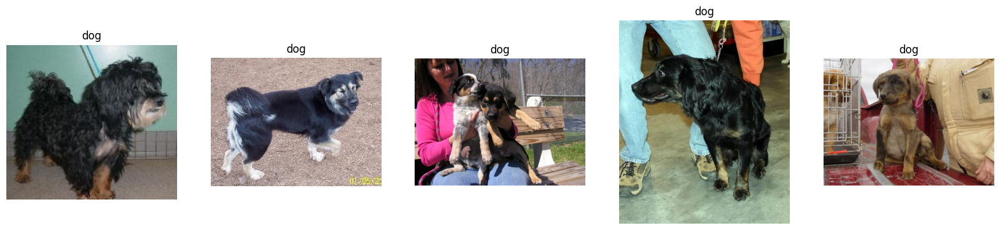

In [118]:
display_similar_images(dogs[7])

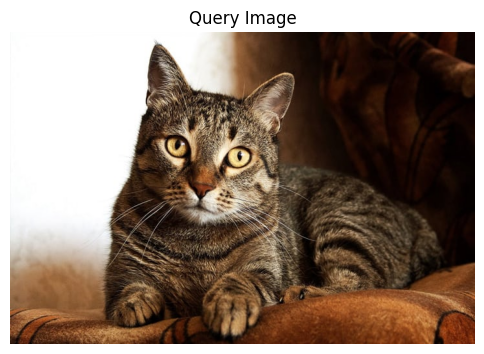

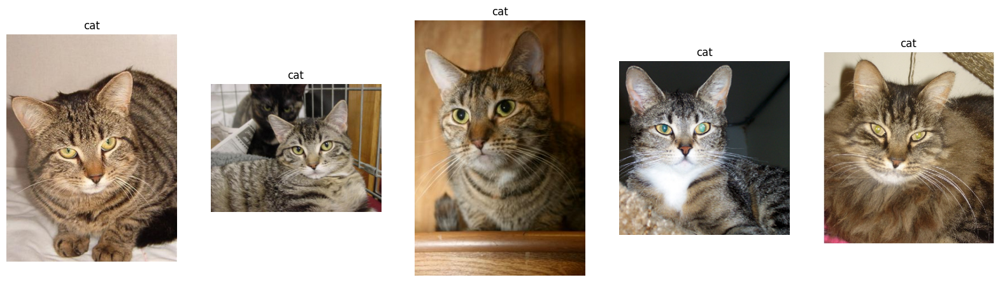

In [119]:
display_similar_images(cats[0])

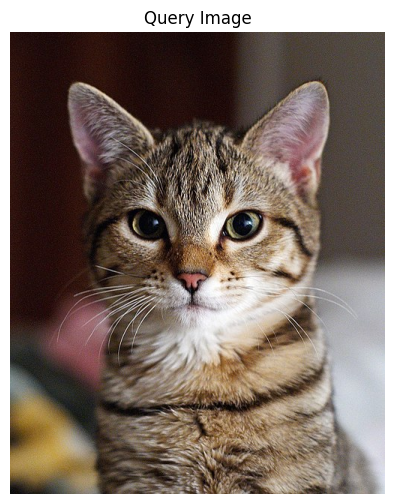

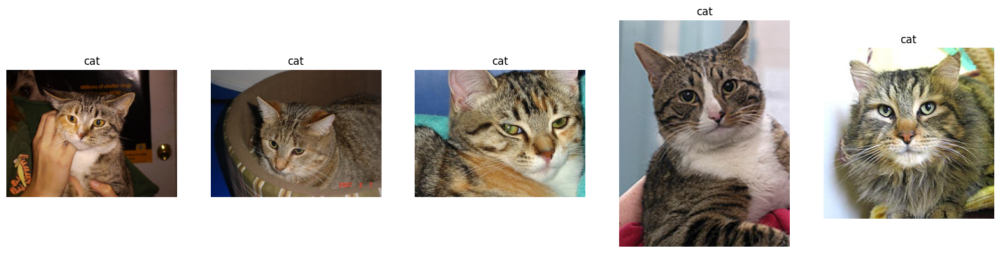

In [120]:
display_similar_images(cats[1])

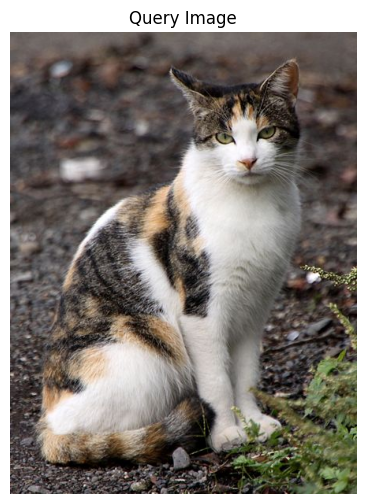

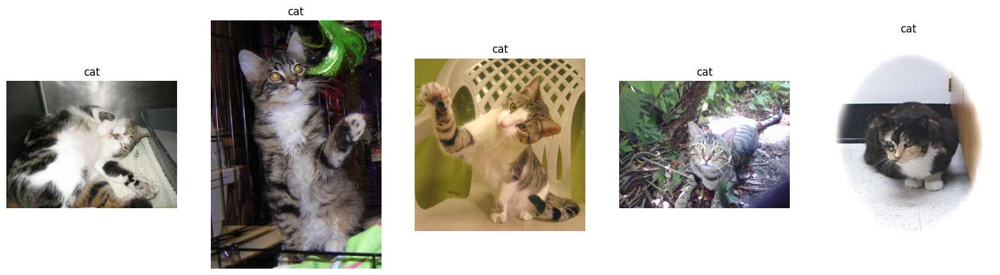

In [121]:
display_similar_images(cats[2])

## Wrapping Up


In this section, we studied the idea of **feature extraction**, a fundamental technique in machine learning and computer vision. Feature extraction transforms raw data into meaningful features that models can use to learn patterns and make accurate predictions. By capturing essential information from the data, feature extraction enables models to perform complex tasks efficiently.

If you are not amazed by the power of feature extraction and similarity search, think again! Feature extraction and similarity search are the backbone of many modern applications, including:

- **Recommendation Systems**: Suggesting items based on user preferences.
- **Content-Based Filtering**: Identifying relevant content by analyzing its features.
- **Reverse Image Search**: Finding images similar to a query image.

Remember from the previous lessons:

>
> #### The Philosophical Aspect
>
> Consider this: What makes a dog... a dog? Imagine describing a dog to someone who has never seen one. You would talk about key characteristics like shape, size, fur, etc. This touches on a philosophical idea proposed by Plato, suggesting that there exists an ideal form or essence for everything. For dogs, this "Form of Dog" represents the perfect essence, encapsulating what it means to be a dog. In the context of CNNs, features are the essence of an object that helps in recognizing it. This essence is learned by the network during training and is represented by a dense vector containing the object's key attributes. This is usually know as an **embedding**.
>

Our simple, pre-trained model was able to capture the essence of images and compute embeddings. These embeddings allowed us to not only identify photos of dogs and cats correctly but also find specific breeds or colors of dogs. It's almost as if these embeddings were able to truly capture the essence of a dog or a cat. Not bad, right Plato?

-----

# Questions

1. What is computer vision and why is it important?

2. How does image classification differ from object detection?

3. What is image segmentation and how does it compare to object detection?

4. Explain the concept of transfer learning in the context of computer vision models.

5. What are some common challenges in computer vision tasks?

6. How do convolutional neural networks (CNNs) work for image processing?

7. What is the purpose of data augmentation in training computer vision models?

8. Describe the process of feature extraction in computer vision.

9. What are embeddings and how are they used in similarity search?

10. Explain the concept of Intersection over Union (IoU) in object detection evaluation.

`Answers are commented inside this cell`

<!--

1. Computer vision is the field of AI that enables computers to derive meaningful information from digital images, videos and other visual inputs. It's important because it allows machines to perceive and understand visual data similar to humans, enabling applications like facial recognition, autonomous vehicles, medical imaging analysis, etc.

2. Image classification assigns a single label to an entire image, while object detection identifies and locates multiple objects within an image using bounding boxes.

3. Image segmentation partitions an image into multiple segments or objects, labeling each pixel. It provides more detailed information about object shapes and boundaries compared to object detection which uses bounding boxes.

4. Transfer learning uses a pre-trained model as a starting point for a new task, leveraging knowledge gained from one problem to solve a related one. In computer vision, models pre-trained on large datasets are fine-tuned for specific tasks.

5. Common challenges include varying lighting conditions, occlusions, scale variations, complex backgrounds, and limited training data.

6. CNNs use layers of convolutional filters to automatically learn hierarchical features from images, from low-level edges to high-level object parts, enabling effective image analysis.

7. Data augmentation artificially expands the training dataset by applying transformations like rotations, flips, and color changes to existing images. This helps improve model generalization and robustness.

8. Feature extraction transforms raw image data into a set of numerical features that capture relevant information. In deep learning, this often involves using pre-trained models to compute embeddings.

9. Embeddings are dense vector representations of data points (e.g. images). In similarity search, embeddings of different items are compared to find similar ones, often using metrics like cosine similarity.

10. IoU measures the overlap between predicted and ground truth bounding boxes. It's calculated as the area of intersection divided by the area of union, providing a metric for object detection accuracy. -->